Importing libraries

In [69]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from scipy.stats import multivariate_normal
from mpl_toolkits.mplot3d import Axes3D
import tensorflow as tf
import tensorflow_probability as tfp
from scipy.stats import norm
import plotly.graph_objects as go
import autograd.numpy as np
from autograd import grad

In [80]:
x = np.linspace(0,10,10)
y = np.linspace(0,10,10)
xx,yy = np.meshgrid(x,y)
xx = xx.reshape(-1)
yy = yy.reshape(-1)
pts = []
for i in range(100):
  pts.append((xx[i], yy[i]))
  if i == 15:
    break
pts

In [82]:
xx[:5]

array([0.        , 1.11111111, 2.22222222, 3.33333333, 4.44444444])

In [85]:
pts = []
for i in range(100):
  pts.append((xx[i], yy[i]))
  if i == 15:
    break
pts = np.asarray(pts)

In [87]:
pts.shape

(16, 2)

#### Optimization Algo's

* Adagrad --> optimizer A
* Adam --> optimizer B
* Rms_prop --> optimizer C

In [89]:
def Adagrad(func, points, max_iter = 20, step = 0.1, algo = 1):
    # func: function
    # points: np array of len 2
    points = points.astype(float)
    end_points = []
    reward = []
    eta = 10**-8
    grad_sq = np.zeros(max_iter + 1) # for tracking grad_squared
    for i in range(max_iter): # iterating
        rew, grad = func(points) # current reward and grad
        grad = grad[algo - 1] # which dimestion you are concerned with
        grad_sq[i + 1] = grad_sq[i] + np.square(grad) #updating grad_squared
        points[algo - 1] = points[algo - 1] + (step * grad)/np.sqrt(grad_sq[i + 1] + eta) #updating the points
        end_points.append(list(points)) #tracking evolution of points
        reward.append(rew)
    return points, end_points, reward



def Adam(func, points, max_iter = 20, step = 0.1, algo = 2, beta1 = 0.9, beta2 = 0.999):
    # func: function
    # points: np array of len 2
  points = points.astype(float)
  end_points = []
  reward = []
  eta = 10**-8
  momentum = np.zeros(max_iter + 1)# for tracking grad momentum
  square = np.zeros(max_iter + 1)# for tracking grad_squared
  for i in range(max_iter): # iterating
    rew, grad = func(points)# current reward and grad
    grad = grad[algo - 1]# which dimestion you are concerned with
    momentum[i + 1] = beta1 * momentum[i] + (1 - beta1) * grad #updating grad momentum
    square[i + 1] = beta2 * square[i] + (1 - beta2) * np.square(grad)#updating grad_squared
    mbar = momentum[i + 1]/(1 - beta1) # using momentum to calculate mbar 
    vbar = square[i + 1]/(1 - beta2) # using grad_Squared to calculate vbar
    points[algo - 1] = points[algo - 1] + (step * mbar)/(np.sqrt(vbar) + eta) #updating points
    end_points.append(list(points)) #tracking evolution of points
    reward.append(rew)
  return points, end_points, reward


def Rmsprop_2d(func, points,  max_iter = 100, beta = 0.9, step = 0.1):
    # func : function
    # points: np array of len = 2

  end_points_x = []
  end_points_y = []
  reward = []
  points = points.astype(float)
  grad_sq = np.zeros((2, max_iter + 1))# for tracking grad_squared
  for i in range(max_iter): #iterating
    rew, grad = func(points)# current reward and grad
    reward.append(rew)
    grad_sq[0][i+1] = grad_sq[0][i] * beta + (1- beta) * np.square(grad[0])#updating grad_squared for x direction
    grad_sq[1][i+1] = grad_sq[1][i] * beta + (1- beta) * np.square(grad[1])#updating grad_squared for y direction
    points[0] = points[0] + step* grad[0]/np.sqrt(grad_sq[0][i+1]) #updating x point
    points[1] = points[1] + step* grad[1]/np.sqrt(grad_sq[1][i+1]) #updating y point
    end_points_x.append(points[0])
    end_points_y.append(points[1])
  end_points_x = np.asarray(end_points_x) #tracking evolution of points x
  end_points_y = np.asarray(end_points_y) #tracking evolution of points y
  reward = np.asarray(reward)
  return points, end_points_x, end_points_y, reward


### **Prisoner Dilemma Surfaces**

These 3 functions are used to make continous prisoner dilemma surfaces:

* pda --> prisoner dilemma for app A
* pdb --> prisoner dilemma for app B
* pd  --> Joint payoff surface

In [90]:
def pda(x, p = 10):

  # p: the maximum point for each axis
  a = x[0] # value of x
  b = x[1] # value of y
  if type(a) == np.ndarray: # for plotting purpose
    Z = 3*a*b + 5*(p-a)*b + 1*(p-a)*(p-b) # The dilemma equation
    return Z, np.array([-b-p, 0]) # returning the corresponding value and gradient


  
  if (a<0)|(a>p): # the setting only exist between 0 and p (maximum point of axis)
    return 0, np.array([0,0]) # zero elsewhere
  Z = 3*a*b + 5*(p-a)*b + 1*(p-a)*(p-b)  # The dilemma equation
  return Z, np.array([-b-p, 0]) # returning the corresponding value and gradient

In [91]:
def pdb(x, p = 10):
  # p: the maximum point for each axis
  a = x[0] # value of x
  b = x[1] # value of y
  if type(a) == np.ndarray: # for plotting purpose
    Z = 3*a*b + 5*(p-b)*a + 1*(p-a)*(p-b)  # The dilemma equation
    return Z, np.array([0, -a-p]) # returning the corresponding value and gradient


  
  if (b<0)|(b>p): # the setting only exist between 0 and p (maximum point of axis)
    return 0, np.array([0,0]) # zero elsewhere
  Z = 3*a*b + 5*(p-b)*a + 1*(p-a)*(p-b) # The dilemma equation
  return Z, np.array([0, -a-p])# returning the corresponding value and gradient

In [92]:
def pd(x, p = 10):
  # p: the maximum point for each axis
  a = x[0] # value of x
  b = x[1] # value of y
  if type(a) == np.ndarray: # for plotting purpose
    Z = 6*a*b + 5*(p-a)*b + 2*(p-a)*(p-b) + 5*(p-b)*a # The dilemma equation
    return Z, np.array([-2*b + 3*p, -2*a + 3*p]) # returning the corresponding value and gradient

  if (a<0)|(a>p)|(b<0)|(b>p):  # the setting only exist between 0 and p (maximum point of axis)
    return 0, np.array([0,0]) # zero elsewhere


  Z = 6*a*b + 5*(p-a)*b + 2*(p-a)*(p-b) + 5*(p-b)*a # The dilemma equation
  return Z, np.array([-2*b + 3*p, -2*a + 3*p]) # returning the corresponding value and gradient

### **Surface Plots**

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = pda(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title='Surface_A', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = pdb(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title='Surface_B', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = pd(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title='Joint Surface', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

Text(0.5, 0, 'Joint Payoff')

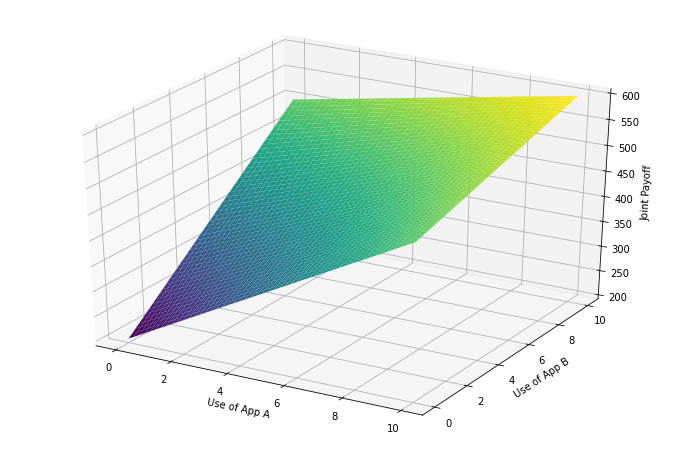

In [ ]:
p = 10
xx, yy = tf.meshgrid(tf.linspace(0.,p,100), tf.linspace(0.,p,100))
summ = xx+yy
Z,_ = pd(np.array([xx, yy]), p = p) 

fig = plt.figure(figsize= (12,8))
ax = fig.add_subplot(111, projection = '3d')

ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
ax.set_xlabel('Use of App A')
ax.set_ylabel('Use of App B')
ax.set_zlabel('Joint Payoff')

### **PD Tracking**

These functions basically shows evolution on prisoner dilemma surfaces:

Remember the labels:
* 0 --> defect
* 10 --> coordinate

**pd_tracking:** The purpose of the function is to show the evolution of points and conclude that irrespective whichever is the starting point, we will always stuck up in the worst possible position.

**pd_tracking2:** optimizer A is run on prisoner dilemma surface A and optimizer B on prisoner dilemma surface B (which gives us a new point i-e pnew), optimizer C runs on joint surface (p3), then the weighted average is taken between pnew and p3 and that becomes our next point. The function further calculates the suboptimality (difference from maximum position) for the given random starting points.

**PDevolution:** helps in making evolution plots

**so_plots:** helps in making suboptimality plots

In [93]:
def pd_tracking(pda, pdb, pd, max_itr = 100, point = 100, p = 10):

  so = [] #suboptimality
  so1 = [] #suboptimality2
  so2 = [] #suboptimality2

  pointss = [] # our next points to record evolution over surface
  r11 = [] # record the evolution reward for surface A
  r22 = []# record the evolution reward for surface B
  pj = []# record new points on joint surface
  r3j = []# record the evolution reward for joint surface

  pts = np.random.uniform(0, 5, size = (point, 2)) # randomly generating starting points
  for i in range(pts.shape[0]): # looping over starting points
    start = pts[i,:] # start becomes our first point
    if  i ==0: # for printing the starting point
      print(start) #printing starting point
    pnew = start # pnew is cloned same as start
    p3 = start # p3 is cloned same as start

    for m in range(max_itr):

      p1, e1, r1 = Adagrad(pda, pnew, max_iter= 1) # optimizer A running on surface A
      p2, e2, r2 = Adam(pdb, pnew, max_iter= 1)# optimizer B running on surface B
      p3, e3x, e3y, r3 = Rmsprop_2d(pd, p3, max_iter= 1)# optimizer C running on joint surface
 
  ### to ensure all points stay between 0 and p (maximum point on axis)
      if p2[1] < 0.:
        p2[1] = 0
      if p1[0]<0.:
        p1[0] = 0
      if p3[0]>p:
        p3[0] = p
      if p3[1] >p:
        p3[1] = p

  #############################################
      pnew = np.array([p1[0], p2[1]]) # new points given to us by optimizer a and optimizer b
      less,_ = pd(pnew) # the reward of joint surface at our new point
      
      if i == 0:
        so.append(r3[0] - less) # suboptimality of new point on joint surface
        pointss.append(pnew) # recording evolution
        r11.append(r1[0]) # reward of surface A
        r22.append(r2[0])# reward of surface B
        pj.append(p3)# recording evolution for joint surface
        r3j.append(r3[0])# reward of joint surface
      if i ==1:
        so1.append(r3[0] - less) # for 2nd starting point, recording suboptimality for plot
      if i ==2:
        so2.append(r3[0] - less) # for 3rd starting point, recording suboptimality for plot
  tx, ty = np.asarray(pointss).T #unzipping x and y points of evolution for surface A and B
  jx, jy = np.asarray(pj).T#unzipping x and y points of evolution for joint surface 

  ## plotting evoltion for all 3 surfaces
  PDevolution(pda, "PDA evolution", tx, ty, r11)
  PDevolution(pdb, "PDB evolution", tx, ty, r22)
  PDevolution(pd, "Joint", jx, jy, r3j)
  plt.style.use('ggplot')


  # plotting subplots for 3 starting points, which shows wherever you start, you end up at the same worst position
    
  fig, ax = plt.subplots(1, 3, figsize= (18,8))


  ax[0].plot(np.arange(max_itr), so)
  ax[0].set_xlabel("Number of iterations")
  ax[0].set_ylabel("Suboptimalities")
  ax[1].plot(np.arange(max_itr), so1)
  ax[1].set_xlabel("Number of iterations")
  ax[1].set_ylabel("Suboptimalities")
  ax[2].plot(np.arange(max_itr), so2)
  ax[2].set_xlabel("Number of iterations")
  ax[2].set_ylabel("Suboptimalities")

In [94]:
def pd_tracking2(pda, pdb, pd, max_itr = 100, point = 100, p = 10, w = np.array([0.5,0.5])):
  maxi = 500
  maxi_joint = 600

  so_h =[] # suboptimality of human
  so_a = []# suboptimality of surface A
  so_b = []# suboptimality of Surface B

  pointss = [] # evolution of points
  r11 = [] # record the evolution reward for surface A
  r22 = []# record the evolution reward for surface B
  r33 = []# record the evolution reward for surface human

  pts = np.random.uniform(0, 10, size = (point, 2))# randomly generating starting points
  for i in range(pts.shape[0]): #iterating over starting points
    start = pts[i,:] # start becomes our first point
    if  i ==0:
      print(start)# for printing the starting point
    pw = start # pw is cloned same as start
    # p3 = start

    for m in range(max_itr):

      p1, e1, r1 = Adagrad(pda, pw, max_iter= 1)# optimizer A running on surface A
      p2, e2, r2 = Adam(pdb, pw, max_iter= 1)# optimizer B running on surface B
      p3, e3x, e3y, r3 = Rmsprop_2d(pd, pw, max_iter= 1)# optimizer C running on human

      ### to ensure all points stay between 0 and p (maximum point on axis)
 
      if p2[1] < 0.:
        p2[1] = 0
      if p1[0]<0.:
        p1[0] = 0
      if p3[0]>p:
        p3[0] = p
      if p3[1] >p:
        p3[1] = p
      pnew = np.array([p1[0], p2[1]])# new points given to us by optimizer a and optimizer b
      pw = (1-w) * pnew + w*p3 # taking the weighted average 
      if i == 0:
  
        pointss.append(pnew)
        r11.append(r1[0])
        r22.append(r2[0])
        r33.append(r3[0])

    
    so_a.append(maxi - r1[0])# suboptimality of surface A
    so_b.append(maxi - r2[0])# suboptimality of surface B
    so_h.append(maxi_joint - r3[0])# suboptimality of surface human

  
  tx, ty = np.asarray(pointss).T # unzipping starting points

  ## tracking evolutions for surface A, B and human
  PDevolution(pda, "PDA evolution", tx, ty, r11) 
  PDevolution(pdb, "PDB evolution", tx, ty, r22)
  PDevolution(pd, "Joint", tx, ty, r33)
    
 ### plotting suboptimaities for all surfaces
  sx, sy = pts.T
  so_plot(sx, sy, so_a, label = "Sub-optimalities for A")
  so_plot(sx, sy, so_b, label = "Sub-optimalities for B")
  so_plot(sx, sy, so_h, label = "Sub-optimalities for Joint")
  return np.asarray(so_a), np.asarray(so_b), np.asarray(so_h), pts

In [95]:
## The funciton is used to plot evolutions

def PDevolution(surface, label, ex, ey, ez):
  # rnew,_ = surface(pw)
  xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
  Z,_ = surface(np.array([xx, yy])) 
  fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy), go.Scatter3d(
    x=ex,
    y=ey,
    z=ez,
    mode='markers',
    marker=dict(
        size=6,
        color= '#ff0000',                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    ))])
  fig.update_layout(title=label , autosize=False,
                    width=500, height=500,
                    margin=dict(l=65, r=50, b=65, t=90))
  # fig.add_scatter3d(x=ex, y=ey,z = ez, mode='markers')
  fig.add_scatter3d(x=[ex[-1]], y=[ey[-1]],z = [ez[-1]], mode='markers')
  fig.show()

In [96]:
## The funciton is used to plot suboptimalities

def so_plot(x,y,z, label):
  fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z,
                                   mode='markers')])
  fig.update_layout(scene = dict(
                    xaxis_title='starting point x',
                    yaxis_title='starting point y',
                    zaxis_title=label),
                    width=700,
                    margin=dict(r=20, b=10, l=10, t=10))
  fig.show()

In [ ]:
pd_tracking(pda, pdb, pd, point= 5, max_itr= 50)

In [ ]:
pda_so, pdb_so, pdj_so, pts =  pd_tracking2(pda, pdb, pd, point= 500, max_itr= 15)

[0.64723263 0.453269  ]


###Human Behavour 

Assumed surface functions for:

* human
* surface A
* surface B

In [97]:
def human(x, mean = 10, std = 4.):
  ## depicting human behaviour
  # x: points where you want to know behaviour

  p = x # p cloning x
  x = x[0] + x[1] # human behaviour depends upon sum of usage of both apps(x and y)
  x = tf.convert_to_tensor(x, dtype= tf.float32)  # convert x to tensor to track gradient

  tfd = tfp.distributions
  dist = tfd.Normal(loc= mean, scale= std) # declaring normal dist with mean 10 (max hrs that can be spended by human) and std  = 4
  with tf.GradientTape(persistent= True) as g: # looking after gradient
    g.watch(x)
    Z = dist.prob(x) # reward value for x
  grad = (g.gradient(Z, x)).numpy() # gradient at x
  # s, grad_sig = sigmoid_x(p)
  grad = np.array([grad, grad]) # grad is same for both dim because our point is sum of x and y
  
  Z = Z*10 # making max reward = 1
  return Z, grad # returning func value and grad

In [98]:
# defining surface A

def Surface_A(x, beta = 0.6, start = 2):
  s = 1/(1 + np.exp(-1*beta*(x[0] - start))) # sigmoid function with start = 2, and beta is how quickly it should rise(hyperparameter)
  grad = np.array([s* (1-s), 0]) #gradient of sigmoid
  #grad = s*(1-s)
  #s = tf.convert_to_tensor(s, dtype= tf.float32)
  return s, grad # returning func value and grad

In [99]:
# defining surface B

def Surface_B(x, beta = 0.6, start = 2):
  s = 1/(1 + np.exp(-1*beta*(x[1] - start)))# sigmoid function with start = 2, and beta is how quickly it should rise(hyperparameter)
  grad = np.array([0, s* (1-s)])#gradient of sigmoid
  return s, grad# returning func value and grad

In [15]:
# this surface is summation of surface A and human behaviour
# but according to our intuition, the interaction should be multiplication of two surfaces rather than addition so this is just an extra effort

def S_HA(x, mean = 10, std = 4.):

  ## drawing human surface -- same as above
  p = x
  x = x[0] + x[1]
  x = tf.convert_to_tensor(x, dtype= tf.float32)

  tfd = tfp.distributions
  dist = tfd.Normal(loc= mean, scale= std)
  with tf.GradientTape(persistent= True) as g:
    g.watch(x)
    Z = dist.prob(x) 
  grad = (g.gradient(Z, x)).numpy()

  
  s, grad_sig = Surface_A(p, start = 10)## calling surface A here and recording its value
  grad = np.array([grad + grad_sig[0], grad])# new gradient -- only effects x bcz gradient for sigmoid with respect to y is 0
  
  Z = Z*7 + s # summing up func values
  return Z, grad # returing gradient and func value

In [16]:
# this surface is summation of surface B and human behaviour
# but according to our intuition, the interaction should be multiplication of two surfaces rather than addition so this is just an extra effort

def S_HB(x, mean = 10, std = 4.):
  ## drawing human surface -- same as above

  p = x
  x = x[0] + x[1]
  x = tf.convert_to_tensor(x, dtype= tf.float32)

  tfd = tfp.distributions
  dist = tfd.Normal(loc= mean, scale= std)
  with tf.GradientTape(persistent= True) as g:
    g.watch(x)
    Z = dist.prob(x) 
  grad = (g.gradient(Z, x)).numpy()

  s, grad_sig = Surface_B(p, start = 10)## calling surface B here and recording its value
  grad = np.array([grad , grad + grad_sig[1]])# new gradient -- only effects y bcz gradient for sigmoid with respect to x is 0
  
  Z = Z*7 +  s# summing up func values
  return Z, grad# returing gradient and func value

### plots of human, surfaceA and surface B

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = human(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' Surface', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

Text(0.5, 0, 'Human behavour reward')

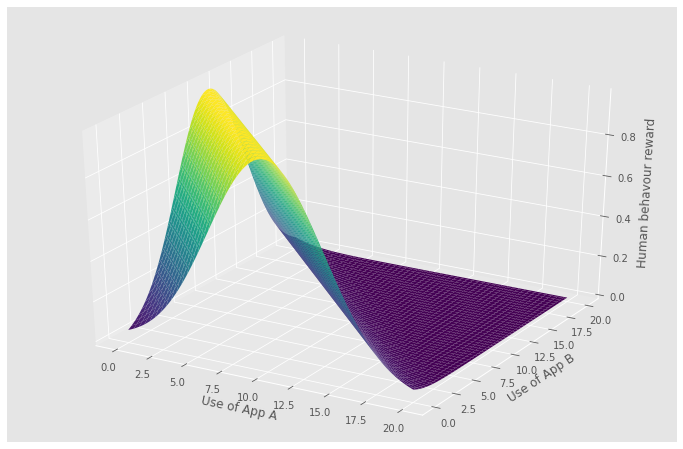

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,20.,100), tf.linspace(0.,20.,100))
summ = xx+yy
Z,_ = human(np.array([xx, yy])) 

fig = plt.figure(figsize= (12,8))
ax = fig.add_subplot(111, projection = '3d')

ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
ax.set_xlabel('Use of App A')
ax.set_ylabel('Use of App B')
ax.set_zlabel('Human behavour reward')

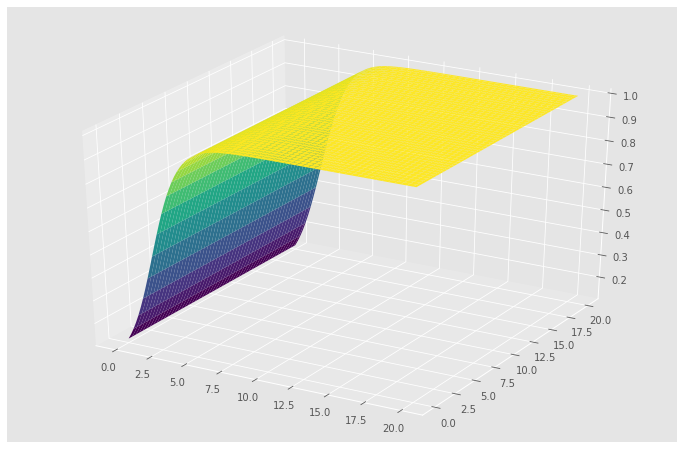

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,20.,100), tf.linspace(0.,20.,100))
summ = xx+yy
Z,_ = Surface_A(np.array([xx, yy]), 1) 

fig = plt.figure(figsize= (12,8))
ax = fig.add_subplot(111, projection = '3d')

ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,20.,100), tf.linspace(0.,20.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = Surface_A(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' Surface', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

Text(0.5, 0, 'Human behavour reward')

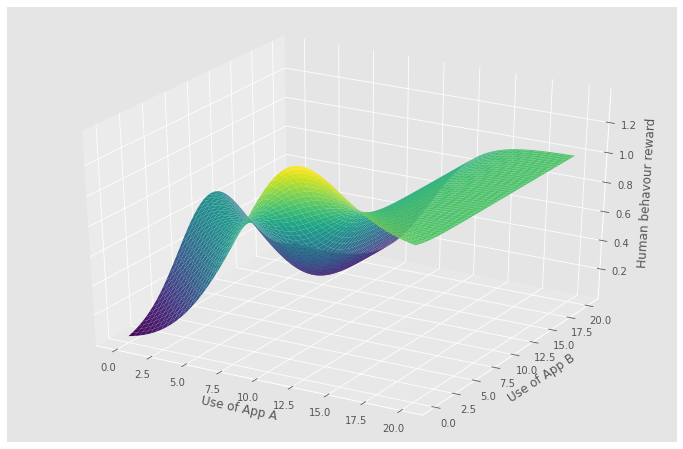

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,20.,100), tf.linspace(0.,20.,100))
summ = xx+yy
Z,_ = S_HA(np.array([xx, yy])) 

fig = plt.figure(figsize= (12,8))
ax = fig.add_subplot(111, projection = '3d')

ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
ax.set_xlabel('Use of App A')
ax.set_ylabel('Use of App B')
ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,20.,100), tf.linspace(0.,20.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = S_HA(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' Surface', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

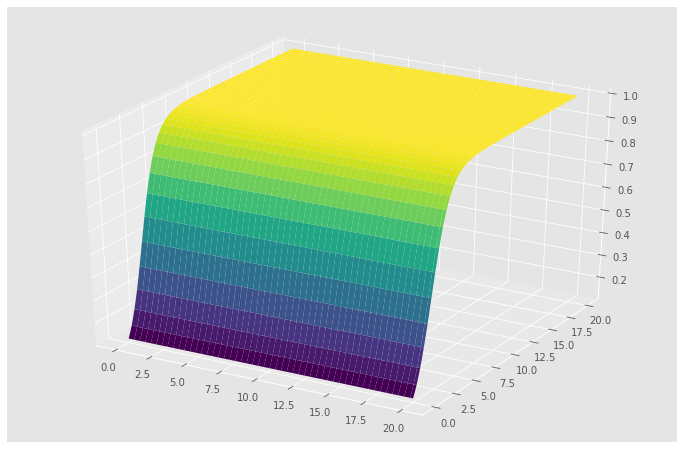

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,20.,100), tf.linspace(0.,20.,100))
summ = xx+yy
Z,_ = Surface_B(np.array([xx, yy]),1) 

fig = plt.figure(figsize= (12,8))
ax = fig.add_subplot(111, projection = '3d')

ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

Text(0.5, 0, 'Human behavour reward')

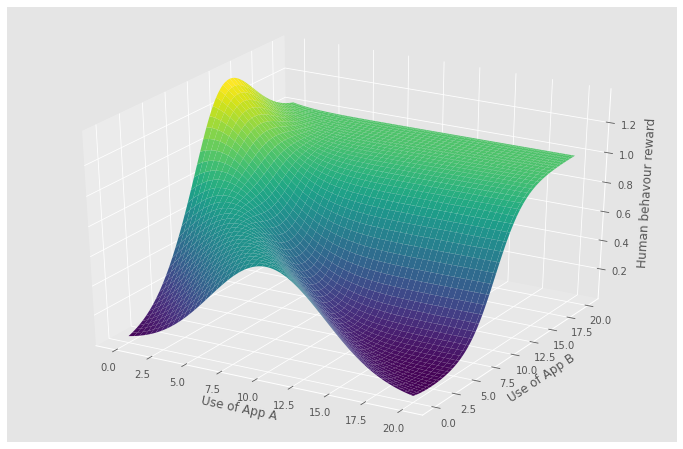

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,20.,100), tf.linspace(0.,20.,100))
summ = xx+yy
Z,_ = S_HB(np.array([xx, yy])) 

fig = plt.figure(figsize= (12,8))
ax = fig.add_subplot(111, projection = '3d')

ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
ax.set_xlabel('Use of App A')
ax.set_ylabel('Use of App B')
ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,20.,100), tf.linspace(0.,20.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = S_HB(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' Surface', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = human(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' Surface', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
# def surface3(x, mean = 10, std = 4.):
#   p = x
#   x = x[0] + x[1]
#   x = tf.convert_to_tensor(x, dtype= tf.float32)

#   tfd = tfp.distributions
#   dist = tfd.Normal(loc= mean, scale= std)
#   with tf.GradientTape(persistent= True) as g:
#     g.watch(x)
#     Z = dist.prob(x) 
#   grad = (g.gradient(Z, x)).numpy()
#   sx, grad_sigx = sigmoid_x(p, start = 2)
#   sy, grad_sigy = sigmoid_y(p, start = 2)
#   grad = np.array([grad + grad_sigx , grad + grad_sigy])
  
#   Z = Z*7 + sx + sy
#   return Z, grad

In [ ]:
# xx, yy = tf.meshgrid(tf.linspace(0.,20.,100), tf.linspace(0.,20.,100))
# summ = xx+yy
# Z,_ = surface3(np.array([xx, yy])) 

# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
# xx, yy = tf.meshgrid(tf.linspace(0.,20.,100), tf.linspace(0.,20.,100))
# # xx = yy = np.linspace(0,15,100)
# Z,_ = surface3(np.array([xx, yy])) 
# fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
# fig.update_layout(title=' Surface', autosize=False,
#                   width=500, height=500,
#                   margin=dict(l=65, r=50, b=65, t=90))
# fig.show()
# # fig = plt.figure(figsize= (12,8))
# # ax = fig.add_subplot(111, projection = '3d')

# # ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# # ax.set_xlabel('Use of App A')
# # ax.set_ylabel('Use of App B')
# # ax.set_zlabel('Human behavour reward')

#### Checking for prisoner's dilemma

In [ ]:
# start = np.array([0,0]) ## starting point

In [ ]:
# p1,e1,r = Adagrad(surface, start, 100, step = 0.5) ## ruunning optimizer A 
# print("agent1 gives", p1,"and reward is ", r[-1])
# p2,e2,r2 = Adam(surface2, start, 100) # running optimizer B
# print("agent2 gives", p2, "and reward is", r2[-1])
# overall_pt = np.array([p1[0], p2[1]]) # combining the x and y from optimizer A and B
# print("overall pt is", overall_pt)

agent1 gives [13.00405567  0.        ] and reward is  tf.Tensor(1.4801514, shape=(), dtype=float32)
agent2 gives [ 0.         14.33368423] and reward is tf.Tensor(1.3753659, shape=(), dtype=float32)
overall pt is [13.00405567 14.33368423]


In [ ]:
# f1,e3,r3 = Adagrad(surface3, start, 100, step = 0.5)
# f2,e4,r4 = Adam(surface3, start, 100)
# print(f1)
# print(f2)

[13.00405567  0.        ]
[ 0.         14.33368423]


In [ ]:
# e1x, e1y = np.array(e1).T
# e2x, e2y = np.array(e2).T
# e3x, e3y = np.array(e3).T
# e4x, e4y = np.array(e4).T

In [ ]:
# xx, yy = tf.meshgrid(tf.linspace(0.,20.,100), tf.linspace(0.,20.,100))
# summ = xx+yy
# Z,_ = surface(np.array([xx, yy])) 

# fig = plt.figure(figsize= (20,10))
# ax = fig.add_subplot(131, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0, alpha = 0.5)
# ax.scatter(e1x, e1y, r, s = 50, c = 'blue')
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

# Z2,_ = surface2(np.array([xx, yy])) 

# # fig = plt.figure(figsize= (12,8))
# ax1 = fig.add_subplot(132, projection = '3d')

# ax1.plot_surface(xx, yy, Z2, cmap='viridis',linewidth=0, alpha = 0.5)
# ax1.scatter(e2x, e2y, r2, s = 80, c = 'blue')
# ax1.set_xlabel('Use of App A')
# ax1.set_ylabel('Use of App B')
# ax1.set_zlabel('Human behavour reward')


# newpt = np.array([e1x[-1], e2y[-1]])
# z,_ = surface3(newpt)
# newptx = e1x[-1]
# newpty = e2y[-1]


# Z3,_ = surface3(np.array([xx, yy])) 

# # fig = plt.figure(figsize= (12,8))
# ax2 = fig.add_subplot(133, projection = '3d')

# ax2.plot_surface(xx, yy, Z3, cmap='viridis',linewidth=0, alpha = 0.5)
# ax2.scatter(e3x, e3y, r3, c = 'blue')
# ax2.scatter(e4x, e4y, r4, c = 'blue')

# ax2.scatter(newptx, newpty, z, s = 80, c = 'red')
# ax2.set_xlabel('Use of App A')
# ax2.set_ylabel('Use of App B')
# ax2.set_zlabel('Human behavour reward')

Note:

* Optimizer A ends up at points (xnew,y) --> pa
* Optimizer B ends up at points (x,ynew) --> pb
* Optimizer C ends up at points (xnew,ynew) --> pc

* After applying weights, the points are called pw (point_weighted)

### **Tasks**

* Labels for Algo's + Surfaces
* optimizer A on Surface A
* optimizer B on Surface B
* Optimizer C on Surface Human
* Calculate weighted average (X,Y)
* Plotting Evolutions over all surfaces (SA, SB, SH, S-AH, S-BH)
* Compute suboptimality for Human (max(Xopt, Yopt, SH) - (X,Y))
* Compute suboptimality for SA, SB
* Redo for different starting points
* Plot distribution of suboptimalities across different starting points.

In [ ]:
  x = np.linspace(1,11,25)
  y = np.linspace(1,11,25)
  xx,yy = np.meshgrid(x,y)
  x = xx.reshape(-1)
  y = yy.reshape(-1)
  starting_points = []
  for i in range(625):
    starting_points.append((x[i], y[i]))
  starting_points = np.asarray(starting_points)




  so_a = np.asarray(so_a)
  so_b = np.asarray(so_b)
  so_h = np.asarray(so_h)
  so_surface_plot(xx, yy, so_a.reshape(25,25), label = "Sub-optimalities for A")
  so_surface_plot(xx, yy, so_b.reshape(25,25), label = "Sub-optimalities for B")
  so_surface_plot(xx, yy, so_h.reshape(25,25), label = "Sub-optimalities for human")
  

  
  return so_a, so_b, so_h, starting_points

In [170]:
def suboptimalities2(SA, SB, SH, S_HA, S_HB, max_itr = 100, human_w = np.array([0.5, 0.5])):
  
  so_a = [] #suboptimality for surface A
  so_b = []#suboptimality for surface B
  so_h = []#suboptimality for surface human
  som1 = []#suboptimality for surface S_HA (addition of human and surface A)
  som2 = []#suboptimality for surface S_HB (addition of human and surface B)

  # just for the first starting point, how does the suboptimality change as we progress.


  so1 = []#suboptimality for surface A
  so2 = []#suboptimality for surface B
  so3 = []#suboptimality for surface human
  so4 = []#suboptimality for surface S_HA (addition of human and surface A)
  so5 = []#suboptimality for surface S_HB (addition of human and surface B)

  max_h,_ = SH(np.array([5,5])) # max reward of human
  max_h = max_h.numpy() # converting reward to numpy from tensor
  max_mixture = 1.4 # max value of S_HA and S_HB surface
  pointss = [] # evolutions of ppoints

  r11 = [] # for the first starting point, the evolution of reward of surface A
  r22 = [] # for the first starting point, the evolution of reward of surface B
  r33 = [] # for the first starting point, the evolution of reward of surface human
  r44 = [] # for the first starting point, the evolution of reward of surface S_HA
  r55 = [] # for the first starting point, the evolution of reward of surface S_HB

  x = np.linspace(1,11,25)
  y = np.linspace(1,11,25)
  xx,yy = np.meshgrid(x,y)
  x = xx.reshape(-1)
  y = yy.reshape(-1)
  starting_points = []
  for i in range(625):
    starting_points.append((x[i], y[i]))
  starting_points = np.asarray(starting_points)
  for i in range(starting_points.shape[0]):# iterating over starting pts
    start = starting_points[i,:] # first starting point
    pw = start #cloning pw same as start
    for j in range(max_itr): # taking steps one by one
      p1, e1, r1 = Adagrad(SA, pw, max_iter= 1, step = 0.3) # Optimizer A on surface A
      p2, e2, r2 = Adam(SB, pw, max_iter= 1)# Optimizer B on surface B
      p3, e3x, e3y, r3 = Rmsprop_2d(SH, pw, max_iter= 1)# Optimizer C on surface human
      pha, eha, rha = Adagrad(S_HA, pw, max_iter= 1, step= 0.5)# Optimizer A on surface S_HA
      phb, ehb, rhb = Adam(S_HB, pw, max_iter= 1)# Optimizer A on surface S_HB

      pnew = np.array([p1[0], p2[1]]) # new ptss from optimizer A and optimizer B
      pw = (1-human_w)*pnew + human_w*p3 # weighted average to get weighted points
      if i == 0: # for the first starting pt
        pointss.append(pw) # recording evoltion of points 
        r11.append(r1[0])# recording evolution of reward for surface A
        r22.append(r2[0])# recording evolution of reward for surface B
        r33.append(r3[0])# recording evolution of reward for surface HUMAN
        r44.append(rha[0])# recording evolution of reward for surface S_HA
        r55.append(rhb[0])# recording evolution of reward for surface S_HB
        so3.append(max_h - r3[0])# recording suboptimality for human
        so1.append(1 - r1[0])# recording suboptimality for surface A
        so2.append(1 - r2[0])# recording suboptimality for surface B
        so4.append(max_mixture - rha[0])# recording suboptimality for S_HA
        so5.append(max_mixture - rhb[0])# recording suboptimality for S_HB


  #after one complete cycle of iteration, how has starting pt travelled and suboptimality for it
    so_h.append(max_h - r3[0]) 
    so_a.append(1 - r1[0])
    so_b.append(1 - r2[0])
    som1.append(max_mixture - rha[0])
    som2.append(max_mixture - rhb[0])

    tx, ty = np.asarray(pointss).T # unzipping evolution of pts

    
    if i == 0: # for first starting point, drawing evolution
      print(f"############## Evolutions for trial {i+1} ####################")
      print("starting points are", start)
      tx, ty = np.asarray(pointss).T
      evolution(SA, "Surface A", tx, ty, r11)
      evolution(SB, "Surface B", tx, ty, r22)
      evolution(SH, "Human", tx, ty, r33)
      evolution(S_HA, "S_HA", tx, ty, r44)
      evolution(S_HB, "S_HB", tx, ty, r55)

  
  # for first starting pt, drawing how reward changes
  fig, ax = plt.subplots(1, 5, figsize= (18,8))

  ax[0].plot(np.arange(max_itr), so1)
  ax[0].set_xlabel("Number of iterations")
  ax[0].set_ylabel("Suboptimalities for surface A")
  ax[1].plot(np.arange(max_itr), so2)
  ax[1].set_xlabel("Number of iterations")
  ax[1].set_ylabel("Suboptimalities for surface B")
  ax[2].plot(np.arange(max_itr), so3)
  ax[2].set_xlabel("Number of iterations")
  ax[2].set_ylabel("Suboptimalities for Human")
  ax[3].plot(np.arange(max_itr), so4)
  ax[3].set_xlabel("Number of iterations")
  ax[3].set_ylabel("Suboptimalities for S_HA")
  ax[4].plot(np.arange(max_itr), so5)
  ax[4].set_xlabel("Number of iterations")
  ax[4].set_ylabel("Suboptimalities for S_HB")
  
  ## drawing suboptimality curves

  so_a = np.asarray(so_a)
  so_b = np.asarray(so_b)
  so_h = np.asarray(so_h)
  som1 = np.asarray(som1)
  som2 = np.asarray(som2)
  so_surface_plot(xx, yy, so_a.reshape(25,25), label = "Sub-optimalities for A")
  so_surface_plot(xx, yy, so_b.reshape(25,25), label = "Sub-optimalities for B")
  so_surface_plot(xx, yy, so_h.reshape(25,25), label = "Sub-optimalities for human")  
  so_surface_plot(xx, yy, som1.reshape(25,25), label = "Sub-optimalities for S_HA")
  so_surface_plot(xx, yy, som2.reshape(25,25), label = "Sub-optimalities for S_HB")
   
  return so_a, so_b, so_h, starting_points


In [171]:
# def suboptimalities(SA, SB, SH, S_HA, S_HB, points = 10, max_itr = 100, human_w = np.array([0.5, 0.5])):
  
#   so_a = []
#   so_b = []
#   so_h = []
#   som1 = []
#   som2 = []
#   # max_a, _ = SA(np.array([40,0]))
#   # max_b, _ = SB(np.array([0,40])) 
#   max_h,_ = SH(np.array([5,5]))
#   max_h = max_h.numpy()
#   max_mixture = 1.4

#   starting_points = np.random.uniform(0,15, size = (points, 2))
#   for i in range(starting_points.shape[0]):
#     start = starting_points[i,:]
#     p1, e1, r1 = Adagrad(SA, start, max_iter= max_itr, step = 0.5)
#     p2, e2, r2 = Adam(SB, start, max_iter= max_itr)
#     p3, e3x, e3y, r3 = Rmsprop_2d(SH, start, max_iter= max_itr)
#     pha, eha, rha = Adagrad(S_HA, start, max_iter= max_itr, step= 0.5)
#     phb, ehb, rhb = Adam(S_HB, start, max_iter= max_itr)

#     pnew = np.array([p1[0], p2[1]])
#     pw = (1-human_w)*pnew + human_w*p3
#     # print(f"points: {pnew}, weighted points: {pw}")
#     e1x, e1y = np.array(e1).T
#     e2x, e2y = np.array(e2).T
#     ehax, ehay = np.array(eha).T
#     ehbx, ehby = np.array(ehb).T

#     ### calculating rewards at pw for different surfaces

#     # max_h = max(r3)
#     r_a,_ = Surface_A(pw)
#     r_b,_ = Surface_B(pw)
#     r_h, _ = human(pw)
#     r_h = r_h.numpy()
#     r11, _ = S_HA(pw)
#     r22, _ = S_HB(pw)

#     so_h.append(max_h - r_h)
#     so_a.append(1 - r_a)
#     so_b.append(1 - r_b)
#     som1.append(max_mixture - r11)
#     som2.append(max_mixture - r22)

    
#     if i == 0:
#       print(f"############## Evolutions for trial {i+1} ####################")
#       evolution(SA, "Surface A", e1x, e1y, r1, pw)
#       evolution(SB, "Surface B", e2x, e2y, r2, pw)
#       evolution(SH, "Human", e3x, e3y, r3, pw)
#       evolution(S_HA, "S_HA", ehax, ehay, rha, pw)
#       evolution(S_HB, "S_HB", ehbx, ehby, rhb, pw)

#   sx, sy = starting_points.T
#   so_plot(sx, sy, so_a, label = "Sub-optimalities for A")
#   so_plot(sx, sy, so_b, label = "Sub-optimalities for B")
#   so_plot(sx, sy, so_h, label = "Sub-optimalities for human")
#   so_plot(sx, sy, som1, label = "Sub-optimalities for S_HA")
#   so_plot(sx, sy, som2, label = "Sub-optimalities for S_HB")
  
#   return np.asarray(so_a), np.asarray(so_b), np.asarray(so_h), starting_points

In [172]:
# function for plotting suboptimality

def so_plot(x,y,z, label):
  fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z,
                                   mode='markers')])
  fig.update_layout(scene = dict(
                    xaxis_title='starting point x',
                    yaxis_title='starting point y',
                    zaxis_title=label),
                    width=700,
                    margin=dict(r=20, b=10, l=10, t=10))
  fig.show()

In [173]:
# fucntion for plotting evolution

def evolution(surface, label, ex, ey, ez):
  # rnew,_ = surface(pw)
  xx, yy = tf.meshgrid(tf.linspace(0,10,100), tf.linspace(0,10,100))
  Z,_ = surface(np.array([xx, yy])) 
  fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy), go.Scatter3d(
    x=ex,
    y=ey,
    z=ez,
    mode='markers',
    marker=dict(
        size=12,
        color= '#ff0000',                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    ))])
  fig.update_layout(title=label , autosize=False,
                    width=500, height=500,
                    margin=dict(l=65, r=50, b=65, t=90))
  # fig.add_scatter3d(x=ex, y=ey,z = ez, mode='markers', color = "black")
  fig.add_scatter3d(x=[ex[-1]], y=[ey[-1]],z = [ez[-1]], mode='markers')
  fig.show()

In [174]:
def so_surface_plot(x,y,z, label):
  fig = go.Figure(data=[go.Surface(z=z, x=x, y=y)])
  fig.update_layout(title= label, autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
  fig.show()

############## Evolutions for trial 1 ####################
starting points are [1. 1.]


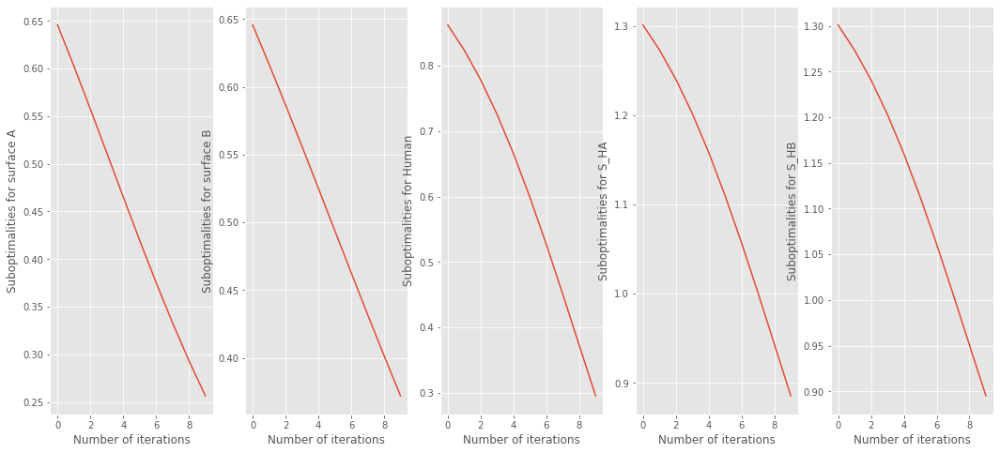

In [175]:
soa, sob, soh, s = suboptimalities2(Surface_A, Surface_B, human, S_HA, S_HB, max_itr= 10)

#### **Analyzing Suboptimalities**

In [ ]:
a,b = pts.T
arg = (a>0)&(a<1)
ca = a[arg]
ss = pda_so[arg]

In [ ]:
def analyze(starting_points, soa, sob, soj, l = 0, h = 0.2):
  #a,b,c = max(soa), max(sob), max(soj)
  ptsx, ptsy = starting_points.T
  arg = (ptsx>l)&(ptsx<h)
  ptsy = ptsy[arg]
  soa = soa[arg]
  sob = sob[arg]
  soj = soj[arg]

  plt.style.use('ggplot')

  fig, ax = plt.subplots(1,3, figsize = (15,8))

  #ax[0].set_ylim(0, a)
  ax[0].scatter(ptsy, soa)
  ax[0].set_title("Starting point Y vs SO- A")
  ax[0].set_xlabel("Y points")
  ax[0].set_ylabel("Suboptimalities")
  #ax[1].set_ylim(0, b)
  ax[1].scatter(ptsy, sob)
  ax[1].set_title("Starting point Y vs SO- B")
  ax[1].set_xlabel("Y points")
  ax[1].set_ylabel("Suboptimalities")
  #ax[2].set_ylim(0, c)
  ax[2].scatter(ptsy, soj)
  ax[2].set_title("Starting point Y vs SO- Joint")
  ax[2].set_xlabel("Y points")
  ax[2].set_ylabel("Suboptimalities")



**For a constant X-value, how does starting value of y effect sub-optimality**

X is defecting here

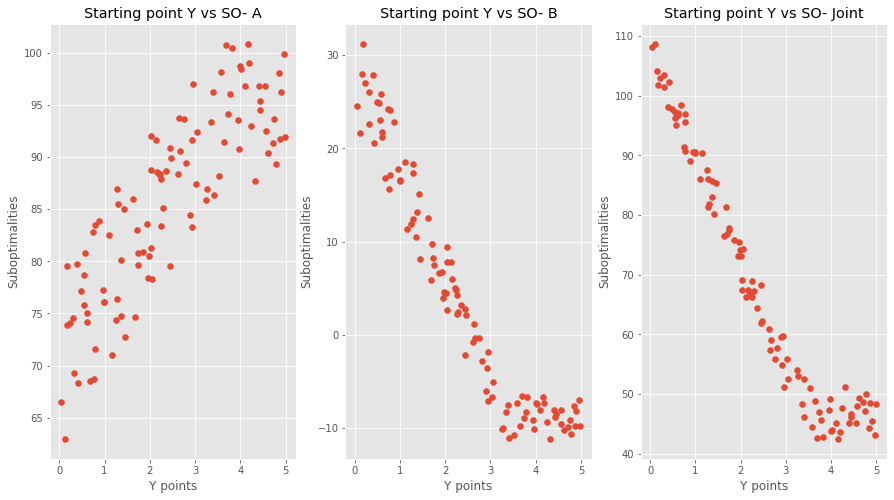

In [ ]:
analyze(pts, pda_so, pdb_so, pdj_so, l = 0, h = 1)

X is cooperting here

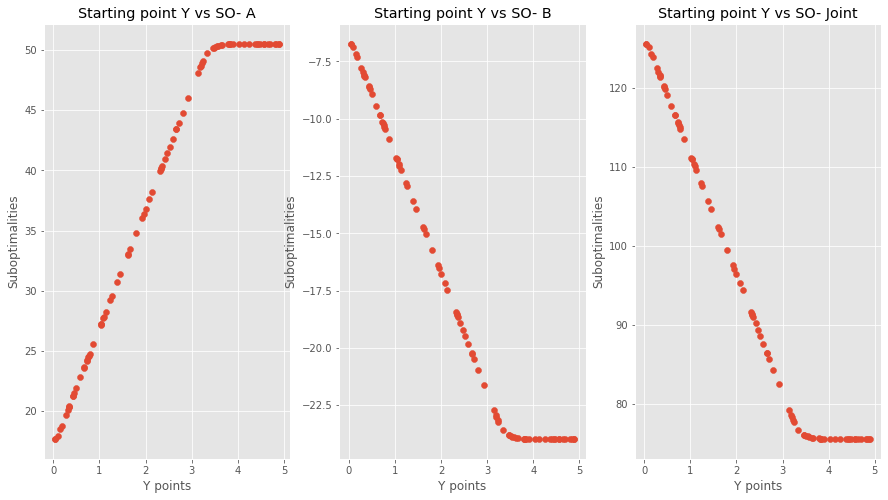

In [ ]:
analyze(pts, pda_so, pdb_so, pdj_so, l = 4, h = 5)

Analyzing second version

X is almost not being used

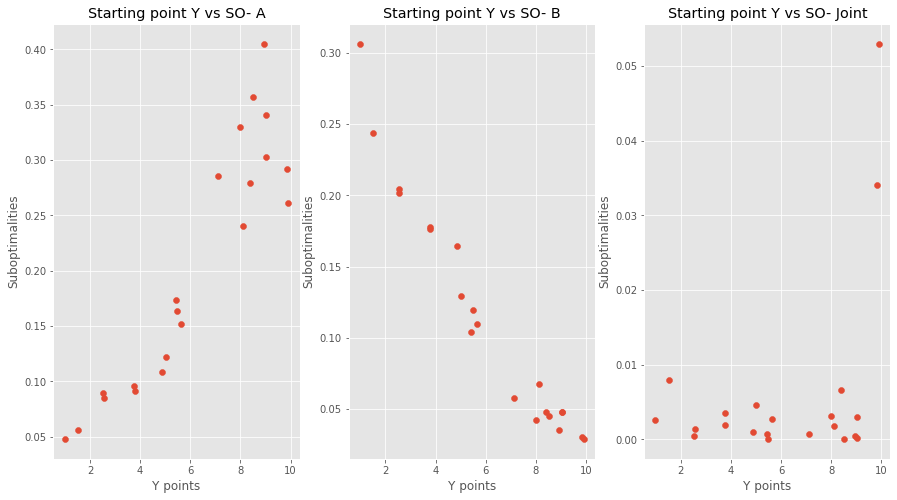

In [ ]:
analyze(s, soa, sob, soh, l = 0, h = 2)

X is being used more

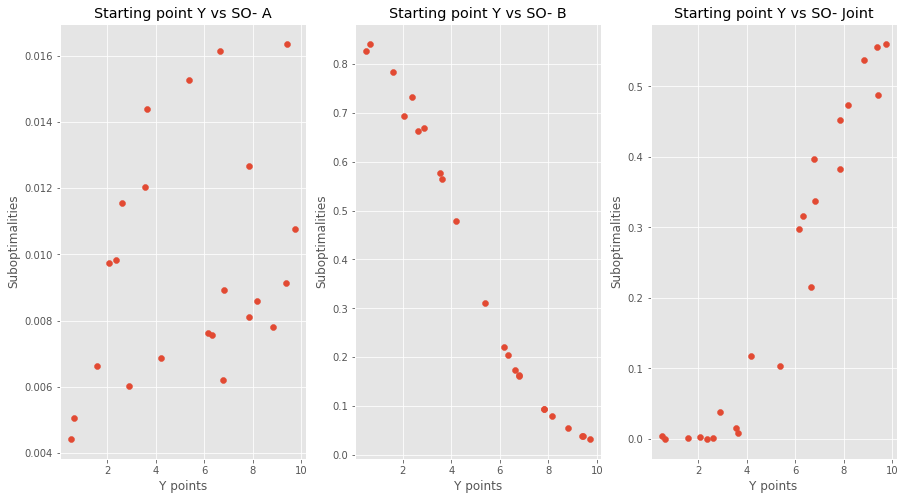

In [ ]:
analyze(s, soa, sob, soh, l = 7, h = 9)

#### **Interactions between surfaces**

* linear_x : linear plane in direction of X
* linear_y : linear plane in direction of Y
* ia :  surface after product of human and linear_x
* ib :  surface after product of human and linear_y
* pda_scaled surfaces are the true representation of prisoner dilemma
* isigA: interaction b/w human and sigmoid_A
* isigB: interaction b/w human and sigmoid_B

the values of pd_scaled depicts: 
* 0 --> coordinate
* 10 --> defect

In [103]:
def linear_x(x):
  if type(x[0]) == np.ndarray: # for plotting purpose
    s = 0.1*x[0] # only dependent on x component
    grad = np.array([0.1, 0]) # constant gradient
    return s, grad
  
  s = 0.1*x[0] # only dependent on x component
  grad = np.array([0.1, 0])# constant gradient
  return s, grad

In [104]:
def linear_y(x):
  if type(x[1]) == np.ndarray:# for plotting purpose
    s = 0.1*x[1] # only dependent on y component
    grad = np.array([0, 0.1])# constant gradient
    return s, grad
  

  s = 0.1*x[1] # only dependent on y component
  grad = np.array([0, 0.1])# constant gradient
  return s, grad

In [105]:
def ia(x):
  if type(x[0]) != np.ndarray:
    if x[0]>10: # to keep the domain in b/w 0 and 10 bcz optimizer may push it above and we are not concerned about that
      x[0] = 10
    if x[1] < 0: # to keep the domain in b/w 0 and 10 bcz optimizer may push it above and we are not concerned about that
      x[1] = 0

  Z1, g1 = linear_x(x) # func 1 --> linear_x returning func value and grad
  Z2, g2 = human(x) # func2 --> human returning func value and grad
  a = Z1*g2[0] + Z2*g1[0] ## grad with respect to x (chain rule)
  b = Z1*g2[1] + Z2*g1[1] ## grad with respect to y (chain rule)
  b = b.numpy()
  a = a.numpy()
  grad = np.array([a, b]) # overall grad
  return Z1*Z2, grad

In [106]:
def ib(x):
  if type(x[0]) != np.ndarray:
    if x[1]>10:# to keep the domain in b/w 0 and 10 bcz optimizer may push it above and we are not concerned about that
      x[1] = 10
    if x[0] < 0:# to keep the domain in b/w 0 and 10 bcz optimizer may push it above and we are not concerned about that
      x[0] = 0

  Z1, g1 = linear_y(x)# func 1 --> linear_y returning func value and grad
  Z2, g2 = human(x)# func2 --> human returning func value and grad
  a = (Z1*g2[1] + Z2*g1[1])## grad with respect to x (chain rule)
  b = Z1*g2[0] + Z2*g1[0]## grad with respect to y (chain rule)
  b = b.numpy()
  a = a.numpy()
  grad = np.array([b,a])# overall grad
  return Z1*Z2, grad

In [107]:
## original representation of prisoner dilemma surfaces

def pda_scaled(x):
  a = x[0]/10 # normalizing x and y, such that every point goes b/w 0 and 1
  b = x[1]/10 # normalizing x and y, such that every point goes b/w 0 and 1
  if type(a) == np.ndarray: # for plotting purpose
    Z = 0.6*a*b + 1*a*(1-b) + 0.2*(1-a)*(1-b) # pd equation
    return Z, np.array([-0.2*b+ 0.8, 0])


  
  if (a>1): # to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
    a = 1

  Z = 0.6*a*b + 1*a*(1-b) + 0.2*(1-a)*(1-b) # pd equation  
  return Z, np.array([-b*10+ 4, 0])

def pdb_scaled(x):
  a = x[0]/10 # normalizing x and y, such that every point goes b/w 0 and 1
  b = x[1]/10 # normalizing x and y, such that every point goes b/w 0 and 1
  if type(b) == np.ndarray:# for plotting purpose
    Z = 0.6*a*b + 1*(1-a)*b + 0.2*(1-a)*(1-b) # pd equation
    return Z, np.array([0, 0.8 - 0.2*a])


  
  if (b>1):# to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
    b = 1
  Z = 0.6*a*b + 1*(1-a)*b + 0.2*(1-a)*(1-b) # pd equation
  return Z, np.array([0, 0.8 - 0.2*a])

def pd_scaled(x):
  a = x[0]/10 # normalizing x and y, such that every point goes b/w 0 and 1
  b = x[1]/10 # normalizing x and y, such that every point goes b/w 0 and 1
  if type(a) == np.ndarray:# for plotting purpose
    Z = 1.2*a*b + 1*(1-a)*b + 0.4*(1-a)*(1-b) + 1*(1-b)*a # pd equation for joint
    return Z, np.array([-0.4*b + 0.6, -0.4*a + 0.6])

  if (a>1):# to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
    a = 1
  if b>1:# to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concernedv
    b = 1


  Z = 1.2*a*b + 1*(1-a)*b + 0.4*(1-a)*(1-b) + 1*(1-b)*a # pd equation for joint
  return Z, np.array([-0.4*b + 0.6, -0.4*a + 0.6])

In [108]:
def isiga(x):
  if type(x[0]) != np.ndarray: # for plotting purpose
    if x[0]>10: # to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
      x[0] = 10
    if x[1] < 0: # to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
      x[1] = 0
  Z1, g1 = Surface_A(x, start = 5)# func 1 --> surface_A returning func value and grad
  Z2, g2 = human(x)# func 2--> human returning func value and grad
  a = (Z1*g2[1] + Z2*g1[1])## grad with respect to x (chain rule)
  b = Z1*g2[0] + Z2*g1[0]## grad with respect to y (chain rule)
  a = a.numpy()
  b = b.numpy()
  grad = np.array([b,a]) #overall_grad
  return Z1*Z2, grad


In [109]:
def isigb(x):
  if type(x[0]) != np.ndarray:
    if x[1]>10:# to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
      x[1] = 10
    if x[0] < 0:# to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
      x[0] = 0
  Z1, g1 = Surface_B(x, start = 5)# func 1 --> surface_B returning func value and grad
  Z2, g2 = human(x)# func 2--> human returning func value and grad
  a = (Z1*g2[1] + Z2*g1[1])## grad with respect to x (chain rule)
  b = Z1*g2[0] + Z2*g1[0]## grad with respect to y (chain rule)
  a = a.numpy()
  b = b.numpy()
  grad = np.array([b,a])#overall_grad
  return Z1*Z2, grad


#### drawing of pda_scaled and interactions

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = ia(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' Interaction of A with human', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = pda_scaled(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' pda_scaled', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = pdb_scaled(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' pdb_scaled', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = pd_scaled(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' pda_scaled', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = isiga(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' SIgmoid_A interaction', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = isigb(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' SIgmoid_B interaction', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = isigb(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' SIgmoid_B interaction', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = linear_x(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' linear_x', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = linear_y(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' linear_y', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = ib(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' Interaction of B with human', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

In [ ]:
xx, yy = tf.meshgrid(tf.linspace(0.,10.,100), tf.linspace(0.,10.,100))
# xx = yy = np.linspace(0,15,100)
Z,_ = human(np.array([xx, yy])) 
fig = go.Figure(data=[go.Surface(z=Z, x=xx, y=yy)])
fig.update_layout(title=' Surface', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
# fig = plt.figure(figsize= (12,8))
# ax = fig.add_subplot(111, projection = '3d')

# ax.plot_surface(xx, yy, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of App A')
# ax.set_ylabel('Use of App B')
# ax.set_zlabel('Human behavour reward')

#### for y = 10, plot of x and z

In [ ]:
p = np.linspace(0,10,100)
q = np.ones(100)*10
a,b = ia(np.array([p,q]))

Text(0.5, 1.0, 'plot for y = 10')

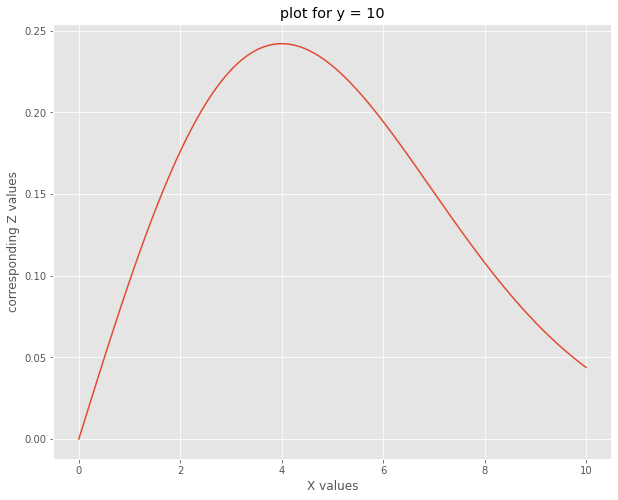

In [ ]:
plt.figure(figsize= (10,8))
plt.style.use('ggplot')
plt.plot(p, a)
plt.xlabel("X values")
plt.ylabel("corresponding Z values")
plt.title("plot for y = 10")

#### Weighted Analysis

* loss: 
optimizer A and B run on interaction A and B respectively which gives our new point i-e pnew. human effort produce new pt i-e p3. weighted average of points p3 and pw give out final movement.

* onlyOptAB:
optimizer A and B run on interaction A and B respectively which gives our new point i-e pnew. only that point is used for further evolution.




In [148]:
def loss(SA, SB, SH, max_itr = 100, human_w = np.array([0.5, 0.5])):
  
  so_a = []#suboptimality for surface A
  so_b = []#suboptimality for surface B
  so_h = []#suboptimality for surface human

  max_h,_ = SH(np.array([5,5])) # max reward of human

  pointss = [] # evolution of points
  r11 = []# for the first starting point, the evolution of reward of surface A
  r22 = []# for the first starting point, the evolution of reward of surface B
  r33 = []# for the first starting point, the evolution of reward of surface human

  #starting_points = np.random.uniform(0,10, size = (points, 2))


  x = np.linspace(1,11,25)
  y = np.linspace(1,11,25)
  xx,yy = np.meshgrid(x,y)
  x = xx.reshape(-1)
  y = yy.reshape(-1)
  starting_points = []
  for i in range(625):
    starting_points.append((x[i], y[i]))
  starting_points = np.asarray(starting_points)

  for i in range(starting_points.shape[0]): # iterating over points
    start = starting_points[i,:] # first point
    pw = start # cloning pw as starting point
    for j in range(max_itr):
      p1, e1, r1 = Adagrad(SA, pw, max_iter= 1, step = 0.1) # optimizer A on Interaction A
      p2, e2, r2 = Adam(SB, pw, max_iter= 1)# optimizer B on Interaction B
      p3, e3x, e3y, r3 = Rmsprop_2d(SH, pw, max_iter= 1)# optimizer C on human surface


      pnew = np.array([p1[0], p2[1]]) # overall new point
      if pnew[0]>10: # to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
        pnew[0] = 10
      if pnew[1]>10: # to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
        pnew[1] = 10
      pw = (1-human_w)*pnew + human_w*p3 # weighted average
      if i == 0: # for first point
        pointss.append(pw) # evolution of points
        r11.append(r1[0])# for the first starting point, the evolution of reward of surface A
        r22.append(r2[0])# for the first starting point, the evolution of reward of surface B
        r33.append(r3[0])# for the first starting point, the evolution of reward of surface huamn

    so_h.append(max_h - r3[0])# recording suboptimality for surface human
    so_a.append(1 - r1[0])# recording suboptimality for surface A
    so_b.append(1 - r2[0])# recording suboptimality for surface B


    tx, ty = np.asarray(pointss).T # unzipping evolution of points

    
    if i == 0:# for first starting point, drawing evolution
      print(f"############## Evolutions for trial {i+1} ####################")
      print("starting points are", start)
      tx, ty = np.asarray(pointss).T
      evolution(SA, "Surface A", tx, ty, r11)
      evolution(SB, "Surface B", tx, ty, r22)
      evolution(SH, "Human", tx, ty, r33)
      # evolution(S_HA, "S_HA", tx, ty, r44)
      # evolution(S_HB, "S_HB", tx, ty, r55)

  ## plotting suboptimalities 
  # sx, sy = starting_points.T
  so_a = np.asarray(so_a)
  so_b = np.asarray(so_b)
  so_h = np.asarray(so_h)
  so_surface_plot(xx, yy, so_a.reshape(25,25), label = "Sub-optimalities for A")
  so_surface_plot(xx, yy, so_b.reshape(25,25), label = "Sub-optimalities for B")
  so_surface_plot(xx, yy, so_h.reshape(25,25), label = "Sub-optimalities for human")
  

  
  return so_a, so_b, so_h, starting_points

In [149]:
a,b,c,d = loss(ia, ib, human, max_itr = 15, human_w= np.array([0.5, 0.5]))

############## Evolutions for trial 1 ####################
starting points are [1. 1.]


In [159]:
def OnlyOptAB(SA, SB, SH, max_itr = 100, human_w = np.array([0.5, 0.5])):
  
  so_a = []#suboptimality for surface A
  so_b = []#suboptimality for surface B
  so_h = []#suboptimality for surface human

  so1 = []
  so2 = []
  so3 = []

  # max_a, _ = SA(np.array([40,0]))
  # max_b, _ = SB(np.array([0,40])) 
  #max_h = max_h.numpy()
  # max_mixture = 1.4
  pointss = [] # evolution of points
  r11 = []# for the first starting point, the evolution of reward of surface A
  r22 = []# for the first starting point, the evolution of reward of surface B
  r33 = []# for the first starting point, the evolution of reward of surface human

  x = np.linspace(1,11,25)
  y = np.linspace(1,11,25)
  xx,yy = np.meshgrid(x,y)
  x = xx.reshape(-1)
  y = yy.reshape(-1)
  starting_points = []
  for i in range(625):
    starting_points.append((x[i], y[i]))
  starting_points = np.asarray(starting_points)

  for i in range(starting_points.shape[0]): # iterating over points
    start = starting_points[i,:] # first point
    pnew = start # cloning pnew as starting point
    for j in range(max_itr):
      p1, e1, r1 = Adagrad(SA, pnew, max_iter= 1, step = 0.1)# optimizer A on Interaction A
      p2, e2, r2 = Adam(SB, pnew, max_iter= 1)# optimizer A on Interaction B
      p3, e3x, e3y, r3 = Rmsprop_2d(SH, pnew, max_iter= 1)# optimizer C on human
      # pha, eha, rha = Adagrad(S_HA, pw, max_iter= 1, step= 0.5)
      # phb, ehb, rhb = Adam(S_HB, pw, max_iter= 1)

      pnew = np.array([p1[0], p2[1]]) #overall new pt
      if pnew[0]>10:# to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
        pnew[0] = 10
      if pnew[1]>10:# to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
        pnew[1] = 10
      # pw = (1-human_w)*pnew + human_w*p3
      if i == 0:
        pointss.append(pnew)# evolution of points
        r11.append(r1[0])# for the first starting point, the evolution of reward of surface A
        r22.append(r2[0])# for the first starting point, the evolution of reward of surface B
        r33.append(r3[0])# for the first starting point, the evolution of reward of surface human


    so_h.append(1 - r3[0])# recording suboptimality for surface human
    so_a.append(1 - r1[0])# recording suboptimality for surface surface A
    so_b.append(1 - r2[0])# recording suboptimality for surface surface B


    tx, ty = np.asarray(pointss).T # unzipping evolution pts

    
    if i == 0: # for first starting point, drawing evolution
      print(f"############## Evolutions for trial {i+1} ####################")
      print("starting points are", start)
      tx, ty = np.asarray(pointss).T
      evolution(SA, "Surface A", tx, ty, r11)
      evolution(SB, "Surface B", tx, ty, r22)
      evolution(SH, "Human", tx, ty, r33)
      # evolution(S_HA, "S_HA", tx, ty, r44)
      # evolution(S_HB, "S_HB", tx, ty, r55)

  ## plotting suboptimalities 
  so_a = np.asarray(so_a)
  so_b = np.asarray(so_b)
  so_h = np.asarray(so_h)
  so_surface_plot(xx, yy, so_a.reshape(25,25), label = "Sub-optimalities for A")
  so_surface_plot(xx, yy, so_b.reshape(25,25), label = "Sub-optimalities for B")
  so_surface_plot(xx, yy, so_h.reshape(25,25), label = "Sub-optimalities for human")
  

  
  return so_a, so_b, so_h, starting_points

In [160]:
_,_,_,_ = OnlyOptAB(ia, ib, human, max_itr= 15)

############## Evolutions for trial 1 ####################
starting points are [1. 1.]


#### Dilemma View

In [35]:
def dilemma(interaction1, interaction2, joint, max_itr = 100, w = np.array([0.5, 0.5]), point = 100):

  so = []#suboptimality for surface A
  so1 = []#suboptimality for surface B
  so2 = []#suboptimality for surface human

  pointss = [] # evolution of points
  r11 = []# for the first starting point, the evolution of reward of surface A
  r22 = []# for the first starting point, the evolution of reward of surface B
  pj = []# new human pts
  r3j = []# for the first starting point, the evolution of reward of surface human

  pts = np.random.uniform(0, 10, size = (point, 2))
  for i in range(pts.shape[0]): 
    start = pts[i,:]# first starting pt
    if  i ==0:
      print(start)
    pnew = start # cloning pnew as start
    p3 = start# cloning p3 as start

    for m in range(max_itr):

      p1, e1, r1 = Adagrad(interaction1, pnew, max_iter= 1) # Running optimizer A on interaction A
      p2, e2, r2 = Adam(interaction2, pnew, max_iter= 1)# Running optimizer B on interaction B
      p3, e3x, e3y, r3 = Rmsprop_2d(joint, p3, max_iter= 1)# Running optimizer C on joint surface

      if p1[0]>10:# to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
        p1[0] = 10
      if p2[1]>10:# to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
        p2[1] = 10

      pnew = np.array([p1[0], p2[1]]) # overall pts
      less,_ = joint(pnew) # reward of joint surface at new overall pt
      
      if i == 0:
        so.append(r3[0] - less) #difference b/w rewards
        pointss.append(pnew)# recording evolution
        r11.append(r1[0])# for the first starting point, the evolution of reward of surface A
        r22.append(r2[0])# for the first starting point, the evolution of reward of surface B
        pj.append(p3)# recording new human evolution pts
        r3j.append(r3[0])# for the first starting point, the evolution of reward of human
      if i ==1: # for second pt, record difference b/w rewards
        so1.append(r3[0] - less)
      if i ==2: # for third pt, record difference b/w rewards
        so2.append(r3[0] - less)
    
  ## UNZIPPING EVOLUTION PTS AND PLOTTING EVOLUTION
  tx, ty = np.asarray(pointss).T
  jx, jy = np.asarray(pj).T
  PDevolution(interaction1, "PDA evolution", tx, ty, r11)
  PDevolution(interaction2, "PDB evolution", tx, ty, r22)
  PDevolution(joint, "Joint", jx, jy, r3j)
  plt.style.use('ggplot')


   ## plotting suboptimality b/w first 3 starting pts
  fig, ax = plt.subplots(1, 3, figsize= (18,8))


  ax[0].plot(np.arange(max_itr), so)
  ax[0].set_xlabel("Number of iterations")
  ax[0].set_ylabel("Suboptimalities")
  ax[1].plot(np.arange(max_itr), so1)
  ax[1].set_xlabel("Number of iterations")
  ax[1].set_ylabel("Suboptimalities")
  ax[2].plot(np.arange(max_itr), so2)
  ax[2].set_xlabel("Number of iterations")
  ax[2].set_ylabel("Suboptimalities")
  # sx, sy = pts.T
  # so_plot(sx, sy, so_a, label = "Sub-optimalities for A")
  # so_plot(sx, sy, so_b, label = "Sub-optimalities for B")
  # so_plot(sx, sy, so_h, label = "Sub-optimalities for human")

[0.21778582 2.9842342 ]


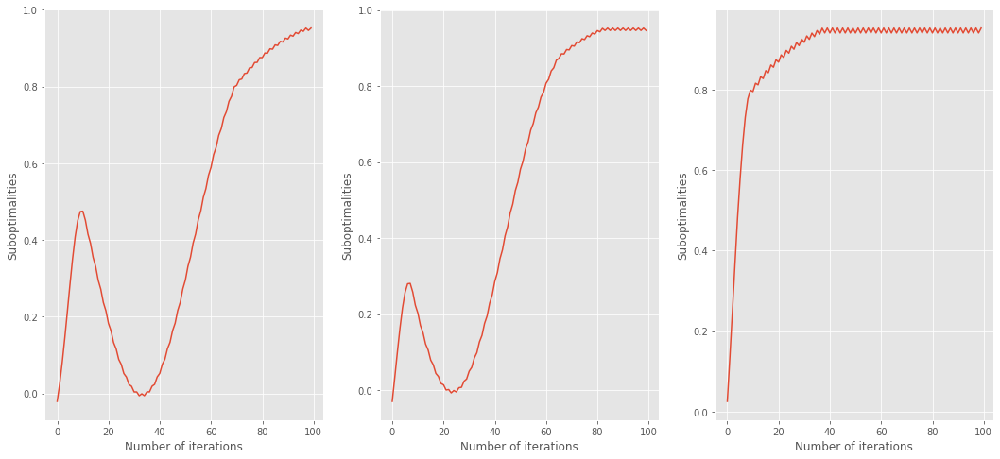

In [36]:
dilemma(ia, ib, human, max_itr= 100, point= 20)

#### Comparison with original Dilemma

In [158]:
a,b,c,d = loss(pda_scaled, pdb_scaled, human, max_itr= 15)

############## Evolutions for trial 1 ####################
starting points are [1. 1.]


#### Both interaction pulled by human

In [37]:
# def interaction(sa, sb, sh, max_iter = 20, points = 100, a_weight = 0.5):
#   soa = [] 
#   sob = []
#   soh = []
#   xx = []
#   yy = []
#   ra = []
#   rb = []
#   rh = []
#   starting_points = np.random.uniform(0,10, size = (points, 2))
#   for i in range(starting_points.shape[0]):
#     start = starting_points[i,:]
#     if i == 0:
#       print("starting point is: ", start)
#     # pw = start
#     for j in range(max_iter):
#       pa, pax, pay, par = Rmsprop_2d(sa, points= start, max_iter= 1)
#       pb, pbx, pby, pbr = Rmsprop_2d(sb, points= start, max_iter= 1)
#       hr,_ = human(start)
#       if i == 0:
#         xx.append(start[0])
#         yy.append(start[1])
#         ra.append(par[0])
#         rb.append(pbr[0])
#         rh.append(hr)
#       start = a_weight*pa + (1-a_weight)*pb

#     # out of iterations:
#     if i == 0:
#       evolution(sa, "Interaction A", np.asarray(xx), np.asarray(yy), np.asarray(ra))
#       evolution(sb, "Interaction B", xx, yy, rb)
#       evolution(sh, "human surface", xx, yy, rh)
#     phr,_ = sh(start)
#     soa.append(1- par[0])
#     sob.append(1 - pbr[0])
#     soh.append(1 - phr)
#   # done with all points:
#   sx, sy = starting_points.T
#   so_plot(sx, sy, soa, "Suboptimalities for surface A")
#   so_plot(sx, sy, sob, "Suboptimalities for surface B")
#   so_plot(sx, sy, soh, "Suboptimalities for human")

    


In [38]:
# interaction(ia, ib, human, max_iter = 15, points= 500, a_weight= 0.7)

#### varying human weights (less dominant human)

Just changing human weights for above loss function which include weighted analysis. 

In [161]:
c1,c2,c3,c4 = loss(ia, ib, human, human_w= np.array([0.2,0.2]), max_itr= 20)

############## Evolutions for trial 1 ####################
starting points are [1. 1.]


#### IsigA and IsigB

* Instead of interaction of human and linear planes, this time, we are using interaction of human and sigmoid to see the analysis of weighted average

* Moreover, we are also running onlyoptAB func which runs optimizer A on interaction A and optimizer B on interaction B. (no weighted average)

In [162]:
p,q,r,s = loss(isiga, isigb, human, max_itr= 15)

############## Evolutions for trial 1 ####################
starting points are [1. 1.]


In [163]:
p,q,r,s = OnlyOptAB(isiga, isigb, human,  max_itr= 15)

############## Evolutions for trial 1 ####################
starting points are [1. 1.]


#### Human controlled other axis

In these both cases:

* optimizer A determines new interaction A point and then human determine the new pt for y axis(usage of appB) --> human_controlled_A

* optimizer B determines new interaction B point and then human determine the new pt for x axis(usage of appA) --> human_controlled_B

In [154]:
def human_controlled_A(SA, SB, SH,  max_itr = 100, human_w = np.array([0.5, 0.5])):
  
  so_a = []#suboptimality for surface A
  so_b = []#suboptimality for surface B
  so_h = []#suboptimality for surface human

  so1 = []
  so2 = []
  so3 = []

  pointss = []# evolution of pts
  r11 = []# for the first starting point, the evolution of reward of surface A
  r22 = []# for the first starting point, the evolution of reward of surface B
  r33 = []# for the first starting point, the evolution of reward of surface human

  x = np.linspace(1,11,25)
  y = np.linspace(1,11,25)
  xx,yy = np.meshgrid(x,y)
  x = xx.reshape(-1)
  y = yy.reshape(-1)
  starting_points = []
  for i in range(625):
    starting_points.append((x[i], y[i]))
  starting_points = np.asarray(starting_points)
  for i in range(starting_points.shape[0]):
    start = starting_points[i,:]
    pnew = start
    for j in range(max_itr):
      p1, e1, r1 = Adagrad(SA, pnew, max_iter= 1, step = 0.1)# optimizer A on Interaction A
      p2, e2, r2 = Adam(SB, pnew, max_iter= 1)# optimizer B on Interaction B
      p3, e3x, e3y, r3 = Rmsprop_2d(SH, pnew, max_iter= 1)# optimizer C on human

      pnew = np.array([p1[0], p3[1]]) #overall pt
      if pnew[0]>10:# to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
        pnew[0] = 10
      if pnew[1]<0:# to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
        pnew[1] = 0
      if i == 0:
        pointss.append(pnew) #evolution of pts
        r11.append(r1[0])# for the first starting point, the evolution of reward of surface A
        r22.append(r2[0])# for the first starting point, the evolution of reward of surface B
        r33.append(r3[0])# for the first starting point, the evolution of reward of surface human


    so_h.append(1 - r3[0]) #recording suboptimality for surface A
    so_a.append(1 - r1[0]) #recording suboptimality for surface B
    so_b.append(1 - r2[0]) #recording suboptimality for surface human


    tx, ty = np.asarray(pointss).T

    
    if i == 0:# for first starting point, drawing evolution
      print(f"############## Evolutions for trial {i+1} ####################")
      print("starting points are", start)
      tx, ty = np.asarray(pointss).T
      evolution(SA, "Surface A", tx, ty, r11)
      evolution(SB, "Surface B", tx, ty, r22)
      evolution(SH, "Human", tx, ty, r33)


  #plotting suboptimality
  so_a = np.asarray(so_a)
  so_b = np.asarray(so_b)
  so_h = np.asarray(so_h)
  so_surface_plot(xx, yy, so_a.reshape(25,25), label = "Sub-optimalities for A")
  so_surface_plot(xx, yy, so_b.reshape(25,25), label = "Sub-optimalities for B")
  so_surface_plot(xx, yy, so_h.reshape(25,25), label = "Sub-optimalities for human")
  

  
  return so_a, so_b, so_h, starting_points

In [155]:
def human_controlled_B(SA, SB, SH, max_itr = 100, human_w = np.array([0.5, 0.5])):
  
  so_a = []#suboptimality for surface A
  so_b = []#suboptimality for surface B
  so_h = []#suboptimality for surface human

  so1 = []
  so2 = []
  so3 = []

  pointss = []# evolution of pts
  r11 = []# for the first starting point, the evolution of reward of surface A
  r22 = []# for the first starting point, the evolution of reward of surface B
  r33 = []# for the first starting point, the evolution of reward of surface human

  x = np.linspace(1,11,25)
  y = np.linspace(1,11,25)
  xx,yy = np.meshgrid(x,y)
  x = xx.reshape(-1)
  y = yy.reshape(-1)
  starting_points = []
  for i in range(625):
    starting_points.append((x[i], y[i]))
  starting_points = np.asarray(starting_points)
  for i in range(starting_points.shape[0]):
    start = starting_points[i,:]
    pnew = start
    for j in range(max_itr):
      p1, e1, r1 = Adagrad(SA, pnew, max_iter= 1, step = 0.3)# optimizer A on Interaction A
      p2, e2, r2 = Adam(SB, pnew, max_iter= 1)# optimizer B on Interaction B
      p3, e3x, e3y, r3 = Rmsprop_2d(SH, pnew, max_iter= 1)# optimizer C on human

      pnew = np.array([p3[0], p2[1]]) #overall pt
      if pnew[1]>10:# to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
        pnew[1] = 10
      if pnew[0]<0:# to keep x and y between 0 and 10 bcz sometime optimizer might take it ahead for which we are not concerned
        pnew[0] = 0
      if i == 0:
        pointss.append(pnew)#evolution of pts
        r11.append(r1[0])# for the first starting point, the evolution of reward of surface A
        r22.append(r2[0])# for the first starting point, the evolution of reward of surface B
        r33.append(r3[0])# for the first starting point, the evolution of reward of surface human


    so_h.append(1 - r3[0])#recording suboptimality for surface A
    so_a.append(1 - r1[0])#recording suboptimality for surface B
    so_b.append(1 - r2[0])#recording suboptimality for surface human


    tx, ty = np.asarray(pointss).T#unzipping evolution of pts

    
    if i == 0:# for first starting point, drawing evolution
      print(f"############## Evolutions for trial {i+1} ####################")
      print("starting points are", start)
      tx, ty = np.asarray(pointss).T
      evolution(SA, "Surface A", tx, ty, r11)
      evolution(SB, "Surface B", tx, ty, r22)
      evolution(SH, "Human", tx, ty, r33)
      # evolution(S_HA, "S_HA", tx, ty, r44)
      # evolution(S_HB, "S_HB", tx, ty, r55)

  #plotting suboptimality
  so_a = np.asarray(so_a)
  so_b = np.asarray(so_b)
  so_h = np.asarray(so_h)
  so_surface_plot(xx, yy, so_a.reshape(25,25), label = "Sub-optimalities for A")
  so_surface_plot(xx, yy, so_b.reshape(25,25), label = "Sub-optimalities for B")
  so_surface_plot(xx, yy, so_h.reshape(25,25), label = "Sub-optimalities for human")
  

  
  return so_a, so_b, so_h, starting_points

In [153]:
soa, sob, soh, start = human_controlled_A(ia, ib, human, max_itr= 15)

############## Evolutions for trial 1 ####################
starting points are [1. 1.]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:56: RuntimeWarning:

invalid value encountered in double_scalars

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:57: RuntimeWarning:

invalid value encountered in double_scalars



In [156]:
_,_,_,_ = human_controlled_B(ia, ib, human, max_itr= 15)

############## Evolutions for trial 1 ####################
starting points are [1. 1.]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:56: RuntimeWarning:

invalid value encountered in double_scalars

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:57: RuntimeWarning:

invalid value encountered in double_scalars



#### Sigmoids and human controlled axis

Here all is same except instead of using interaction of human and linear, we are using interaction b/w human and sigmoid

In [164]:
_,_,_,_ = human_controlled_A(isiga, isigb, human, max_itr= 15)

############## Evolutions for trial 1 ####################
starting points are [1. 1.]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:56: RuntimeWarning:

invalid value encountered in double_scalars

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:57: RuntimeWarning:

invalid value encountered in double_scalars



### **All old Work**

In [ ]:
# def human_behavour(x):
#   # x : starting point numpy array
#   x = tf.convert_to_tensor(x, dtype= 'float64')

#   tfd = tfp.distributions
#   A = np.array([5.,5.])
#   var1 = np.array([[7.,0.],[0.,7.]])
#   A = tfd.MultivariateNormalFullCovariance(A, var1)

#   pos = x
#   with tf.GradientTape(persistent= True) as g:
#     g.watch(pos)
#     Z = 3*A.prob(pos)  
#   grad = g.gradient(Z, pos)

#   grad = grad.numpy()
#   return Z*36, grad

In [ ]:
def human_behavour_contradict_appA(x, human_hrs = 6):
  # x : starting point numpy array
  x = tf.convert_to_tensor(x, dtype= 'float64')
  Z = 0
  tfd = tfp.distributions
  var1 = np.array([[1.,0.],[0.,1.]])
  m = {}
  ind = tfd.MultivariateNormalFullCovariance(np.array([10.,0.]), np.array([[2.,0.],[0.,2.]]))
  for i in range(human_hrs + 1):
    pts = np.array([i, human_hrs-i])
    pts = pts.astype(float)
    m[i] = tfd.MultivariateNormalFullCovariance(pts, var1)

  pos = x
  with tf.GradientTape(persistent= True) as g:
    g.watch(pos)
    for j in range(human_hrs + 1):
      Z = Z + 3*m[j].prob(pos)  
    Z = Z + 10*ind.prob(pos)


  grad = grad.numpy()
  return Z, grad

In [ ]:
def human_behavour_contradict_appB(x, human_hrs = 6):
  # x : starting point numpy array
  x = tf.convert_to_tensor(x, dtype= 'float64')
  Z = 0
  tfd = tfp.distributions
  var1 = np.array([[1.,0.],[0.,1.]])
  m = {}
  ind = tfd.MultivariateNormalFullCovariance(np.array([0.,10.]), np.array([[2.,0.],[0.,2.]]))
  for i in range(human_hrs + 1):
    pts = np.array([i, human_hrs-i])
    pts = pts.astype(float)
    m[i] = tfd.MultivariateNormalFullCovariance(pts, var1)

  pos = x
  with tf.GradientTape(persistent= True) as g:
    g.watch(pos)
    for j in range(human_hrs + 1):
      Z = Z + 3*m[j].prob(pos)  
    Z = Z + 10*ind.prob(pos)

  grad = g.gradient(Z, pos)

  grad = grad.numpy()
  return Z, grad

In [ ]:
def human_behavour_complement_appA(x, human_hrs = 6):
  # x : starting point numpy array
  x = tf.convert_to_tensor(x, dtype= 'float64')
  Z = 0
  tfd = tfp.distributions
  var1 = np.array([[1.,0.],[0.,1.]])
  m = {}
  ind = tfd.MultivariateNormalFullCovariance(np.array([10.,0.]), np.array([[2.,0.],[0.,2.]]))
  for i in range(human_hrs + 1):
    pts = np.array([i, i])
    pts = pts.astype(float)
    m[i] = tfd.MultivariateNormalFullCovariance(pts, var1)

  pos = x
  with tf.GradientTape(persistent= True) as g:
    g.watch(pos)
    for j in range(human_hrs + 1):
      Z = Z + 3*m[j].prob(pos)  
    Z = Z + 10*ind.prob(pos)

  grad = g.gradient(Z, pos)

  grad = grad.numpy()
  return Z, grad

In [ ]:
def human_behavour_both(x, human_hrs = 6):
  # x : starting point numpy array
  x = tf.convert_to_tensor(x, dtype= 'float64')
  Z = 0
  tfd = tfp.distributions
  var1 = np.array([[1.,0.],[0.,1.]])
  m = {}
  ind = tfd.MultivariateNormalFullCovariance(np.array([10.,0.]), np.array([[2.,0.],[0.,2.]]))
  ind2 = tfd.MultivariateNormalFullCovariance(np.array([0.,10.]), np.array([[2.,0.],[0.,2.]]))
  for i in range(human_hrs + 1):
    pts = np.array([i, human_hrs - i])
    pts = pts.astype(float)
    m[i] = tfd.MultivariateNormalFullCovariance(pts, var1)

  pos = x
  with tf.GradientTape(persistent= True) as g:
    g.watch(pos)
    for j in range(human_hrs + 1):
      Z = Z + 3*m[j].prob(pos)  
    Z = Z + 10*ind.prob(pos) + 10*ind2.prob(pos)

  grad = g.gradient(Z, pos)

  grad = grad.numpy()
  return Z, grad

In [ ]:
def human_behavour_complement_appB(x, human_hrs = 6):
  # x : starting point numpy array
  x = tf.convert_to_tensor(x, dtype= 'float64')
  Z = 0
  tfd = tfp.distributions
  var1 = np.array([[1.,0.],[0.,1.]])
  m = {}
  ind = tfd.MultivariateNormalFullCovariance(np.array([0.,10.]), np.array([[2.,0.],[0.,2.]]))
  for i in range(human_hrs + 1):
    pts = np.array([i, i])
    pts = pts.astype(float)
    m[i] = tfd.MultivariateNormalFullCovariance(pts, var1)

  pos = x
  with tf.GradientTape(persistent= True) as g:
    g.watch(pos)
    for j in range(human_hrs + 1):
      Z = Z + 3*m[j].prob(pos)  
    Z = Z + 10*ind.prob(pos)

  grad = g.gradient(Z, pos)

  grad = grad.numpy()
  return Z, grad

In [ ]:
# def human_behavour_contradict(x):
#   # x : starting point numpy array
#   x = tf.convert_to_tensor(x, dtype= 'float64')

#   tfd = tfp.distributions
#   A = np.array([3.,7.])
#   var1 = np.array([[3.,0.],[0.,3.]])
#   A = tfd.MultivariateNormalFullCovariance(A, var1)

#   b = np.array([7.,3.])
#   var2 = np.array([[6.,0.],[0.,6.]])
#   b = tfd.MultivariateNormalFullCovariance(b, var2)


#   pos = x
#   with tf.GradientTape(persistent= True) as g:
#     g.watch(pos)
#     Z = 3*A.prob(pos) + 3*b.prob(pos) 
#   grad = g.gradient(Z, pos)
 
#   grad = grad.numpy()
#   return Z*20, grad

In [ ]:
# def human_behavour_complement(x):
#   # x : starting point numpy array
#   x = tf.convert_to_tensor(x, dtype= 'float64')

#   tfd = tfp.distributions
#   A = np.array([8.,8.])
#   var1 = np.array([[7.,0.],[0.,7.]])
#   A = tfd.MultivariateNormalFullCovariance(A, var1)

#   pos = x
#   with tf.GradientTape(persistent= True) as g:
#     g.watch(pos)
#     Z = 3*A.prob(pos)  
#   grad = g.gradient(Z, pos)

#   grad = grad.numpy()
#   return Z*36, grad

### **Test**

In [ ]:
def sigmoid_x(x, beta = 1):
  s = 1/(1 + np.exp(-1*beta*(x[:,:,0] - 10)))
  grad = np.array([s* (1-s), 0])
  s = tf.convert_to_tensor(s)
  return s

In [ ]:
def sigmoid_y(x, beta = 1):
  s = 1/(1 + np.exp(-1*beta*(x[:,:,1] - 10)))
  grad = np.array([s* (1-s), 0])
  s = tf.convert_to_tensor(s)
  return s*0.7

In [ ]:
def test(x, human_hrs = 10):
  

  # x : starting point numpy array
  x = tf.convert_to_tensor(x, dtype= 'float64')
  Z = 0
  tfd = tfp.distributions
  var1 = np.array([[1.,0.],[0.,1.]])
  m = {}
  X = x[:,:,0]
  Y = x[:,:,1]
  # ind = tfd.MultivariateNormalFullCovariance(np.array([10.,0.]), np.array([[2.,0.],[0.,2.]]))
  for i in range(human_hrs + 1):
    pts = np.array([i, human_hrs-i])
    pts = pts.astype(float)
    m[i] = tfd.MultivariateNormalFullCovariance(pts, var1)

  pos = x
  with tf.GradientTape(persistent= True) as g:
    g.watch(pos)
    for j in range(human_hrs + 1):
      Z = Z + 3*m[j].prob(pos)  
    
    Z = Z + sigmoid_x(pos)

  grad = g.gradient(Z, pos)

  grad = grad.numpy()
  return Z, grad

In [ ]:
def test_b(x, human_hrs = 10):
  

  # x : starting point numpy array
  x = tf.convert_to_tensor(x, dtype= 'float64')
  Z = 0
  tfd = tfp.distributions
  var1 = np.array([[1.,0.],[0.,1.]])
  m = {}
  X = x[:,:,0]
  Y = x[:,:,1]
  # ind = tfd.MultivariateNormalFullCovariance(np.array([10.,0.]), np.array([[2.,0.],[0.,2.]]))
  for i in range(human_hrs + 1):
    pts = np.array([i, human_hrs-i])
    pts = pts.astype(float)
    m[i] = tfd.MultivariateNormalFullCovariance(pts, var1)

  pos = x
  with tf.GradientTape(persistent= True) as g:
    g.watch(pos)
    for j in range(human_hrs + 1):
      Z = Z + 3*m[j].prob(pos)  
    
    Z = Z + sigmoid_y(pos)

  grad = g.gradient(Z, pos)

  grad = grad.numpy()
  return Z, grad

In [ ]:
pos[:,:,0].shape

(100, 100)

Text(0.5, 0, 'Human behavour reward')

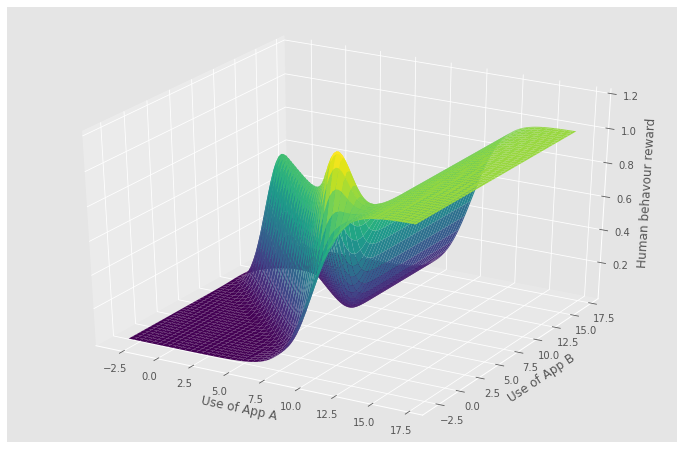

In [ ]:
plt.style.use('ggplot')
x = np.linspace(-3,17,100)
y = np.linspace(-3,17,100)
X, Y = np.meshgrid(x,y)
pos = np.empty(X.shape + (2,))
pos[:, :, 0] = X  
pos[:, :, 1] = Y
c = tf.convert_to_tensor(pos)
Za,_ = test(c)
# Z,_ = sigmoid(np.array([X, Y]), 0.7)


fig = plt.figure(figsize= (12,8))
ax = fig.add_subplot(111, projection = '3d')

ax.plot_surface(X, Y, Za, cmap='viridis',linewidth=0)
ax.set_xlabel('Use of App A')
ax.set_ylabel('Use of App B')
ax.set_zlabel('Human behavour reward')


# ax = fig.add_subplot(122, projection = '3d')
# ax.plot_surface(X, Y, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of app A')
# ax.set_ylabel('Use of app B')
# ax.set_zlabel('Cumulative Reward')

Text(0.5, 0, 'Human behavour reward')

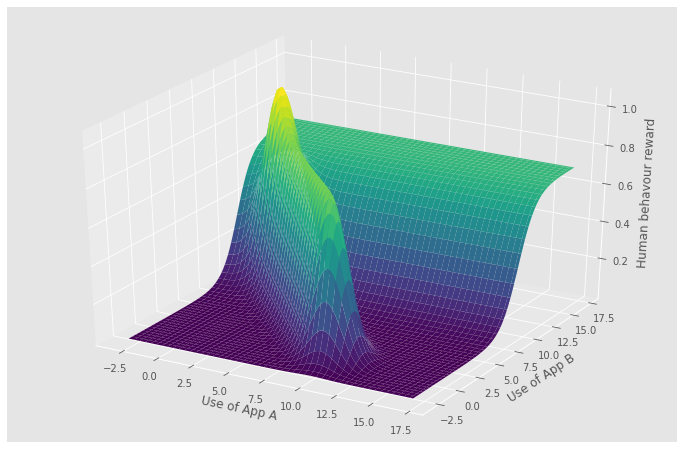

In [ ]:
plt.style.use('ggplot')
x = np.linspace(-3,17,100)
y = np.linspace(-3,17,100)
X, Y = np.meshgrid(x,y)
pos = np.empty(X.shape + (2,))
pos[:, :, 0] = X  
pos[:, :, 1] = Y
c = tf.convert_to_tensor(pos)
Za,_ = test_b(c)
# Z,_ = sigmoid(np.array([X, Y]), 0.7)


fig = plt.figure(figsize= (12,8))
ax = fig.add_subplot(111, projection = '3d')

ax.plot_surface(X, Y, Za, cmap='viridis',linewidth=0)
ax.set_xlabel('Use of App A')
ax.set_ylabel('Use of App B')
ax.set_zlabel('Human behavour reward')


# ax = fig.add_subplot(122, projection = '3d')
# ax.plot_surface(X, Y, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of app A')
# ax.set_ylabel('Use of app B')
# ax.set_zlabel('Cumulative Reward')

In [ ]:
def test_both(x, human_hrs = 10):
  

  # x : starting point numpy array
  x = tf.convert_to_tensor(x, dtype= 'float64')
  Z = 0
  tfd = tfp.distributions
  var1 = np.array([[1.,0.],[0.,1.]])
  m = {}
  X = x[:,:,0]
  Y = x[:,:,1]
  # ind = tfd.MultivariateNormalFullCovariance(np.array([10.,0.]), np.array([[2.,0.],[0.,2.]]))
  for i in range(human_hrs + 1):
    pts = np.array([i, human_hrs-i])
    pts = pts.astype(float)
    m[i] = tfd.MultivariateNormalFullCovariance(pts, var1)

  pos = x
  with tf.GradientTape(persistent= True) as g:
    g.watch(pos)
    for j in range(human_hrs + 1):
      Z = Z + 3*m[j].prob(pos)  
    
    Z = Z + 0.7*sigmoid_y(pos) + 0.7*sigmoid_x(pos)

  grad = g.gradient(Z, pos)

  grad = grad.numpy()
  return Z, grad

Text(0.5, 0, 'Human behavour reward')

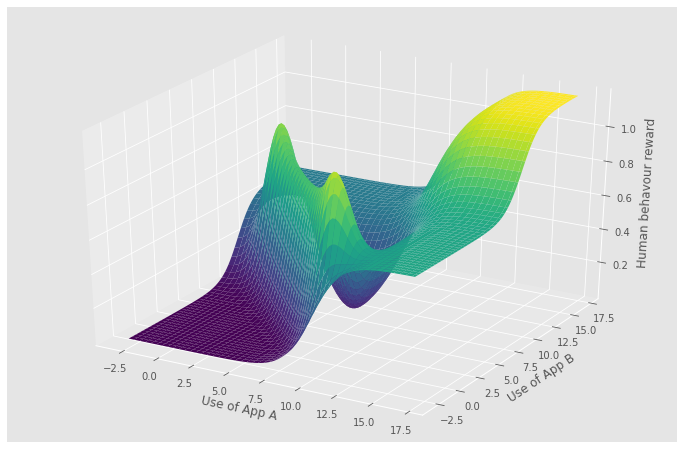

In [ ]:
plt.style.use('ggplot')
x = np.linspace(-3,17,100)
y = np.linspace(-3,17,100)
X, Y = np.meshgrid(x,y)
pos = np.empty(X.shape + (2,))
pos[:, :, 0] = X  
pos[:, :, 1] = Y
c = tf.convert_to_tensor(pos)
Za,_ = test_both(c)
# Z,_ = sigmoid(np.array([X, Y]), 0.7)


fig = plt.figure(figsize= (12,8))
ax = fig.add_subplot(111, projection = '3d')

ax.plot_surface(X, Y, Za, cmap='viridis',linewidth=0)
ax.set_xlabel('Use of App A')
ax.set_ylabel('Use of App B')
ax.set_zlabel('Human behavour reward')


# ax = fig.add_subplot(122, projection = '3d')
# ax.plot_surface(X, Y, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of app A')
# ax.set_ylabel('Use of app B')
# ax.set_zlabel('Cumulative Reward')

### **Overall Surface**

In [ ]:
def sigmoid(points, beta = 1):
    a = 1 / (1 + np.exp(-1 * beta * (points[1] - 2)))
    b = 1/(1 + np.exp(-1*beta*(points[0] - 2)))
    grad = np.array([a*(1 - a) , b*(1 - b)])
    return a+b, grad

### **Plotting Surfaces**

Instructions for updating:
`MultivariateNormalFullCovariance` is deprecated, use `MultivariateNormalTriL(loc=loc, scale_tril=tf.linalg.cholesky(covariance_matrix))` instead.


Text(0.5, 0, 'Human behavour reward')

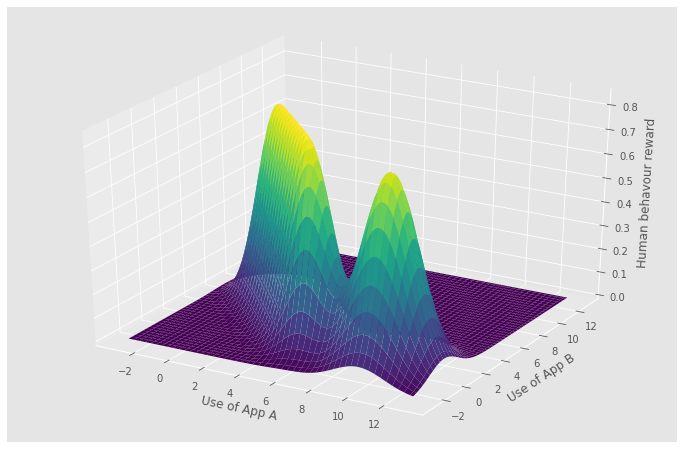

In [ ]:
plt.style.use('ggplot')
x = np.linspace(-3,13,100)
y = np.linspace(-3,13,100)
X, Y = np.meshgrid(x,y)
pos = np.empty(X.shape + (2,))
pos[:, :, 0] = X  
pos[:, :, 1] = Y
c = tf.convert_to_tensor(pos)
Za,_ = human_behavour_contradict_appA(c)
Z,_ = sigmoid(np.array([X, Y]), 0.7)


fig = plt.figure(figsize= (12,8))
ax = fig.add_subplot(111, projection = '3d')

ax.plot_surface(X, Y, Za, cmap='viridis',linewidth=0)
ax.set_xlabel('Use of App A')
ax.set_ylabel('Use of App B')
ax.set_zlabel('Human behavour reward')


# ax = fig.add_subplot(122, projection = '3d')
# ax.plot_surface(X, Y, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of app A')
# ax.set_ylabel('Use of app B')
# ax.set_zlabel('Cumulative Reward')

Text(0.5, 0, 'Human behavour reward')

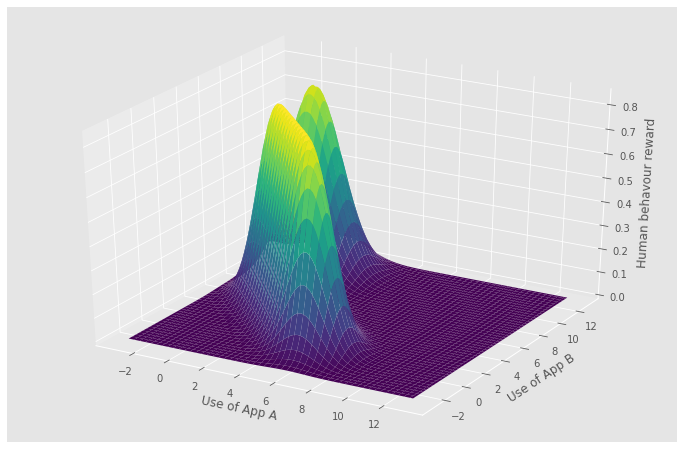

In [ ]:
plt.style.use('ggplot')
x = np.linspace(-3,13,100)
y = np.linspace(-3,13,100)
X, Y = np.meshgrid(x,y)
pos = np.empty(X.shape + (2,))
pos[:, :, 0] = X  
pos[:, :, 1] = Y
c = tf.convert_to_tensor(pos)
Za,_ = human_behavour_contradict_appB(c)
Z,_ = sigmoid(np.array([X, Y]), 0.7)


fig = plt.figure(figsize= (12,8))
ax = fig.add_subplot(111, projection = '3d')

ax.plot_surface(X, Y, Za, cmap='viridis',linewidth=0)
ax.set_xlabel('Use of App A')
ax.set_ylabel('Use of App B')
ax.set_zlabel('Human behavour reward')


# ax = fig.add_subplot(122, projection = '3d')
# ax.plot_surface(X, Y, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of app A')
# ax.set_ylabel('Use of app B')
# ax.set_zlabel('Cumulative Reward')

Text(0.5, 0, 'Human behavour reward')

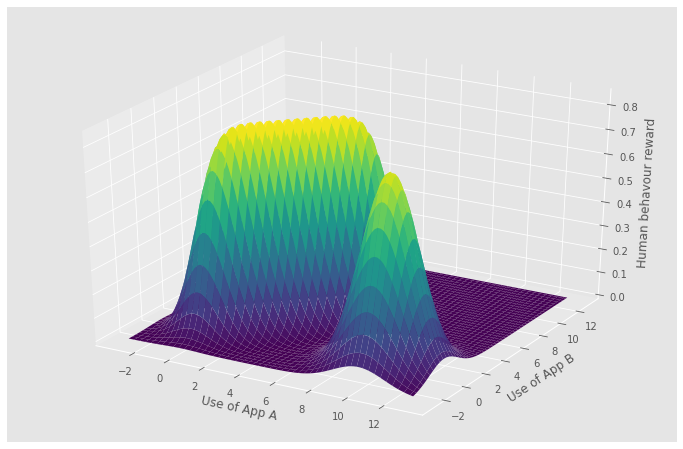

In [ ]:
plt.style.use('ggplot')
x = np.linspace(-3,13,100)
y = np.linspace(-3,13,100)
X, Y = np.meshgrid(x,y)
pos = np.empty(X.shape + (2,))
pos[:, :, 0] = X  
pos[:, :, 1] = Y
c = tf.convert_to_tensor(pos)
Za,_ = human_behavour_complement_appA(c)
Z,_ = sigmoid(np.array([X, Y]), 0.7)


fig = plt.figure(figsize= (12,8))
ax = fig.add_subplot(111, projection = '3d')

ax.plot_surface(X, Y, Za, cmap='viridis',linewidth=0)
ax.set_xlabel('Use of App A')
ax.set_ylabel('Use of App B')
ax.set_zlabel('Human behavour reward')


# ax = fig.add_subplot(122, projection = '3d')
# ax.plot_surface(X, Y, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of app A')
# ax.set_ylabel('Use of app B')
# ax.set_zlabel('Cumulative Reward')

Text(0.5, 0, 'Human behavour reward')

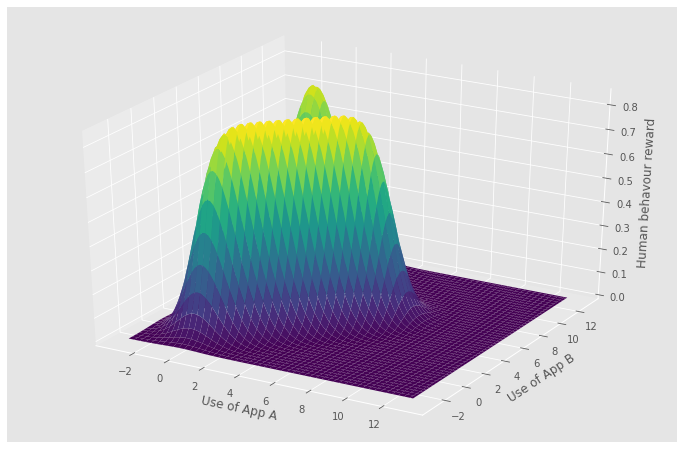

In [ ]:
plt.style.use('ggplot')
x = np.linspace(-3,13,100)
y = np.linspace(-3,13,100)
X, Y = np.meshgrid(x,y)
pos = np.empty(X.shape + (2,))
pos[:, :, 0] = X  
pos[:, :, 1] = Y
c = tf.convert_to_tensor(pos)
Za,_ = human_behavour_complement_appB(c)
Z,_ = sigmoid(np.array([X, Y]), 0.7)


fig = plt.figure(figsize= (12,8))
ax = fig.add_subplot(111, projection = '3d')

ax.plot_surface(X, Y, Za, cmap='viridis',linewidth=0)
ax.set_xlabel('Use of App A')
ax.set_ylabel('Use of App B')
ax.set_zlabel('Human behavour reward')


# ax = fig.add_subplot(122, projection = '3d')
# ax.plot_surface(X, Y, Z, cmap='viridis',linewidth=0)
# ax.set_xlabel('Use of app A')
# ax.set_ylabel('Use of app B')
# ax.set_zlabel('Cumulative Reward')

### **Plotly Testing**

In [ ]:
plt.style.use('ggplot')
x = np.linspace(-3,13,100)
y = np.linspace(-3,13,100)
X, Y = np.meshgrid(x,y)
pos = np.empty(X.shape + (2,))
pos[:, :, 0] = X  
pos[:, :, 1] = Y
c = tf.convert_to_tensor(pos)
Za,_ = human_behavour_contradict_appA(c)

fig = go.Figure(data=[go.Surface(z=Za, x=x, y=y)])
fig.update_layout(title='Contradictory behaviour plus a peak of App A:', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))

In [ ]:
plt.style.use('ggplot')
x = np.linspace(-3,13,100)
y = np.linspace(-3,13,100)
X, Y = np.meshgrid(x,y)
pos = np.empty(X.shape + (2,))
pos[:, :, 0] = X  
pos[:, :, 1] = Y
c = tf.convert_to_tensor(pos)
Za,_ = human_behavour_contradict_appB(c)

fig = go.Figure(data=[go.Surface(z=Za, x=x, y=y)])
fig.update_layout(title='Complementary behaviour plus a peak of App B:', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))

In [ ]:
plt.style.use('ggplot')
x = np.linspace(-3,13,100)
y = np.linspace(-3,13,100)
X, Y = np.meshgrid(x,y)
pos = np.empty(X.shape + (2,))
pos[:, :, 0] = X  
pos[:, :, 1] = Y
c = tf.convert_to_tensor(pos)
Za,_ = human_behavour_both(c)

fig = go.Figure(data=[go.Surface(z=Za, x=x, y=y)])
fig.update_layout(title='Complementary behaviour plus a peak of App B and App A:', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))

## ***Optimization Algo's***

In [ ]:
def Adagrad(func, points, max_iter = 20, step = 0.1, algo = 1):
    # func: function
    # points: np array of len 2
    points = points.astype(float)
    end_points = []
    reward = []
    eta = 10**-8
    grad_sq = np.zeros(max_iter + 1)
    for i in range(max_iter):
        rew, grad = func(points)
        grad = grad[algo - 1]
        grad_sq[i + 1] = grad_sq[i] + np.square(grad)
        points[algo - 1] = points[algo - 1] + (step * grad)/np.sqrt(grad_sq[i + 1] + eta)
        end_points.append(list(points))
        reward.append(rew)
    return points, end_points, reward



def Adam(func, points, max_iter = 20, step = 0.1, algo = 2, beta1 = 0.9, beta2 = 0.999):
    # func: function
    # points: np array of len 2
  points = points.astype(float)
  end_points = []
  reward = []
  eta = 10**-8
  momentum = np.zeros(max_iter + 1)
  square = np.zeros(max_iter + 1)
  for i in range(max_iter):
    rew, grad = func(points)
    grad = grad[algo - 1]
    momentum[i + 1] = beta1 * momentum[i] + (1 - beta1) * grad
    square[i + 1] = beta2 * square[i] + (1 - beta2) * np.square(grad)
    mbar = momentum[i + 1]/(1 - beta1)
    vbar = square[i + 1]/(1 - beta2)
    points[algo - 1] = points[algo - 1] + (step * mbar)/(np.sqrt(vbar) + eta)
    end_points.append(list(points))
    reward.append(rew)
  return points, end_points, reward


def Rmsprop_2d(func, points,  max_iter = 100, beta = 0.9, step = 0.1):
    # func : function
    # points: np array of len = 2

  end_points_x = []
  end_points_y = []
  reward = []
  points = points.astype(float)
  grad_sq = np.zeros((2, max_iter + 1))
  for i in range(max_iter):
    rew, grad = func(points)
    reward.append(rew)
    grad_sq[0][i+1] = grad_sq[0][i] * beta + (1- beta) * np.square(grad[0])
    grad_sq[1][i+1] = grad_sq[1][i] * beta + (1- beta) * np.square(grad[1])
    points[0] = points[0] + step* grad[0]/np.sqrt(grad_sq[0][i+1])
    points[1] = points[1] + step* grad[1]/np.sqrt(grad_sq[1][i+1])
    end_points_x.append(points[0])
    end_points_y.append(points[1])
  end_points_x = np.asarray(end_points_x)
  end_points_y = np.asarray(end_points_y)
  reward = np.asarray(reward)
  return points, end_points_x, end_points_y, reward


### **Tracking**

In [ ]:
start = np.array([0.,0.])

In [ ]:
# def movement(human, general, start, human_weight = [0.5], max_itr = 1):
#   _, phx, phy, hr = Rmsprop_2d(human, start, max_iter = max_itr)
#   _, pgx, pgy, gr = Rmsprop_2d(general, start, max_iter = max_itr)
#   print("hr",hr[-5:])
#   print("final points human", phx[-5:], phy[-5:])
#   for h in human_weight:
#     avg_x = h*phx + (1-h)*pgx
#     avg_y = h*phy + (1-h)*pgy
#     avg_r = h*hr + (1-h)*gr
#     fig = plt.figure(figsize= (12,8))
#     ax = fig.add_subplot(111, projection = '3d')
#     ax.scatter(phx, phy, hr, label = "human behavour trajectory")
#     ax.scatter(pgx, pgy, gr, label = "general behavour trajectory")
#     ax.scatter(avg_x, avg_y, avg_r, label = "trajectory after imposing weights")
#     ax.set_xlabel('Use of app A')
#     ax.set_ylabel('Use of app B')
#     ax.set_zlabel('Reward')
#     ax.set_title("human weight = " + str(h))
#     plt.legend()


In [ ]:
def tracking(optimizer, func, start, max_itr = 100, step = 0.1):
  name = str(func)
  _,l, r = optimizer(func, start, max_iter = max_itr, step = step)
  lx, ly = np.array(l).T
  plt.style.use('ggplot')
  x = np.linspace(-3,13,100)
  y = np.linspace(-3,13,100)
  X, Y = np.meshgrid(x,y)
  pos = np.empty(X.shape + (2,))
  pos[:, :, 0] = X  
  pos[:, :, 1] = Y
  c = tf.convert_to_tensor(pos)
  Za,_ = func(c)


  # fig = plt.figure(figsize= (12,8))
  # ax = fig.add_subplot(111, projection = '3d')
  # ax.plot_surface(X, Y, Za, cmap='viridis',linewidth=0, alpha = 0.5)
  # ax.scatter(lx, ly, r, c = 'k', s = 80)

  # ax.set_xlabel('Use of App A')
  # ax.set_ylabel('Use of App B')
  # ax.set_zlabel('Human behavour reward')

  fig = go.Figure(data=[go.Surface(z=Za, x=x, y=y, opacity= 0.5),go.Scatter3d(x=lx, y=ly, z=r, marker=dict(size=4, color = 'black'),
                                   mode='markers')])
  fig.update_layout(title=name , autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
  fig.show()
 
  # fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z,
  #                                  mode='markers')])




In [ ]:
tracking(Adagrad, human_behavour_contradict_appA, np.array([2,0])) # changes x only

In [ ]:
tracking(Adagrad, human_behavour_contradict_appA, np.array([8,0])) # changes x only

In [ ]:
tracking(Adam, human_behavour_contradict_appA, np.array([2,0]), max_itr = 100, step = 0.1) # Changes y only

from (2,0) --> we end up at (4.75, 4.7)

In [ ]:
tracking(Adam, human_behavour_contradict_appA, np.array([8,0]), max_itr = 100, step = 0.1) # Changes y only

From (8,0) we end up at (10,0)

### **For App B Now**

In [ ]:
tracking(Adagrad, human_behavour_contradict_appB, np.array([2,0])) # changes x only

In [ ]:
tracking(Adagrad, human_behavour_contradict_appB, np.array([0,8])) # changes x only

In [ ]:
tracking(Adam, human_behavour_contradict_appB, np.array([2,0])) # changes y only

From (2,0) we end up at  (4.75, 4.75)

In [ ]:
tracking(Adam, human_behavour_contradict_appB, np.array([0,8])) # changes y only

From (0,8) it end up at (0,10)

From (0,7) it moved to (0,5.6)

### **Both Peaks**

In [ ]:
tracking(Adagrad, human_behavour_both, np.array([3,7])) # only changes x

In [ ]:
tracking(Adam, human_behavour_both, np.array([3,7])) # changes y only

From (3,7), it ends up at (0,3)

In [ ]:
tracking(Adagrad, human_behavour_both, np.array([0,0])) # only changes x

In [ ]:
tracking(Adam, human_behavour_both, np.array([0,0])) # changes y only

From (0,0) it end up at (3,8, 6.2)

In [ ]:
tracking(Adagrad, human_behavour_both, np.array([0,8])) # only changes x

In [ ]:
tracking(Adam, human_behavour_both, np.array([0,8])) # changes y only

### **Independent Behaviour**

hr [2.45553341 2.45553341 2.45553341 2.45553341 2.45553341]
final points human [5. 5. 5. 5. 5.] [5. 5. 5. 5. 5.]


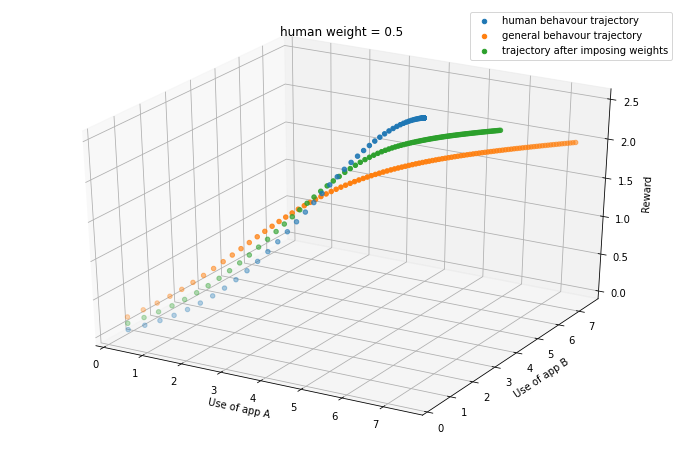

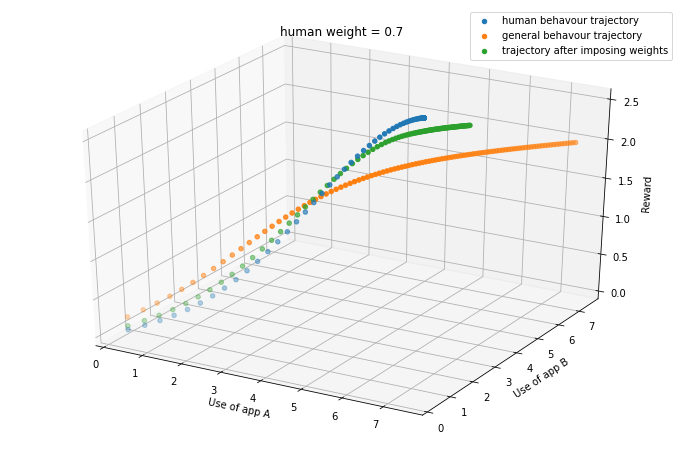

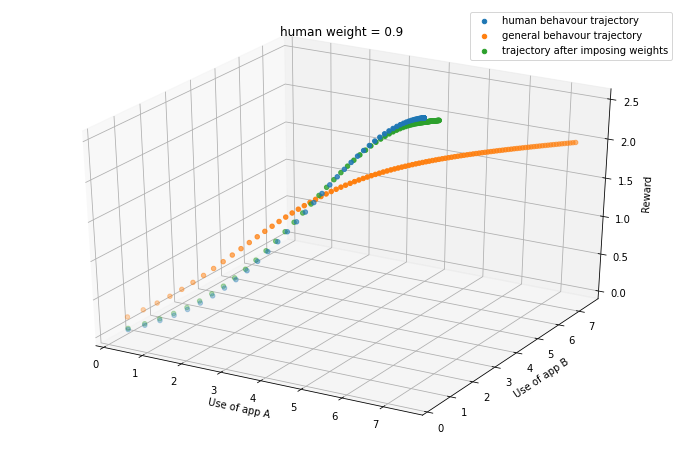

In [ ]:
movement(human_behavour, sigmoid, start, max_itr= 100, human_weight= [0.5, 0.7, 0.9])

### **Contradictory Behaviour**

hr [3.29149331 3.29342481 3.29579511 3.29725369 3.29796734]
final points human [3.13175727 3.03117969 3.11182702 3.0442493  3.10392376] [7.01204552 6.85782886 6.97315541 6.88733861 6.95519547]


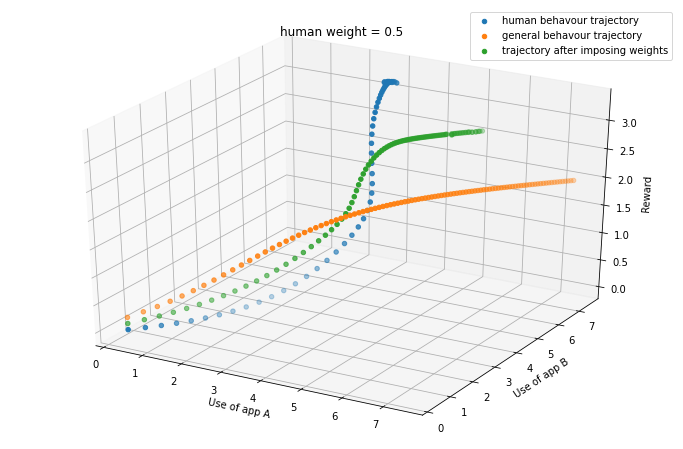

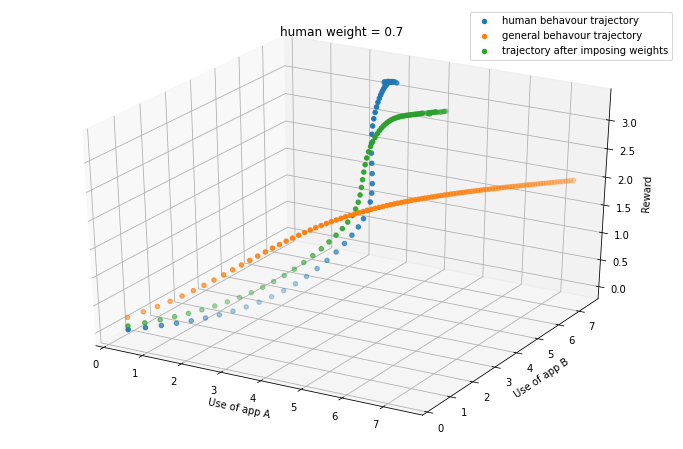

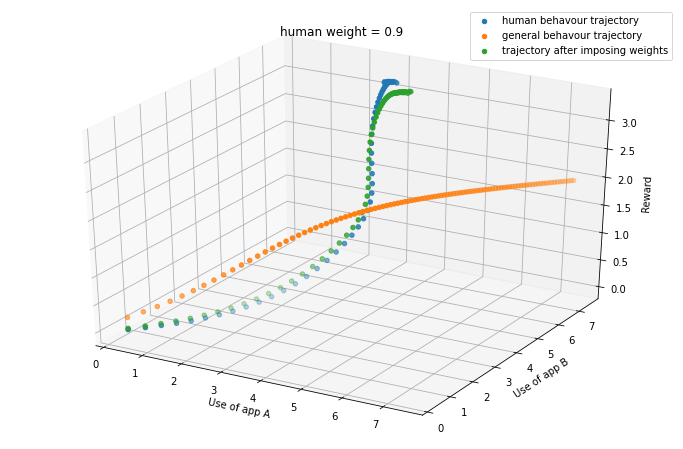

In [ ]:
movement(human_behavour_contradict, sigmoid, start, max_itr= 100, human_weight= [0.5, 0.7, 0.9])

### **Complementary Behaviour**

hr [2.45553341 2.45553341 2.45553341 2.45553341 2.45553341]
final points human [8. 8. 8. 8. 8.] [8. 8. 8. 8. 8.]


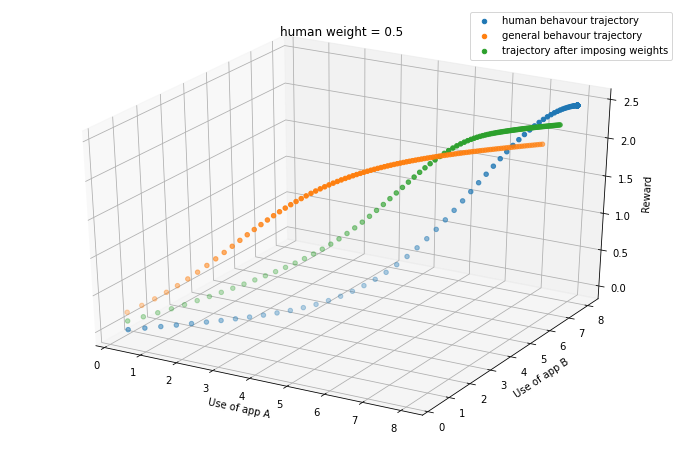

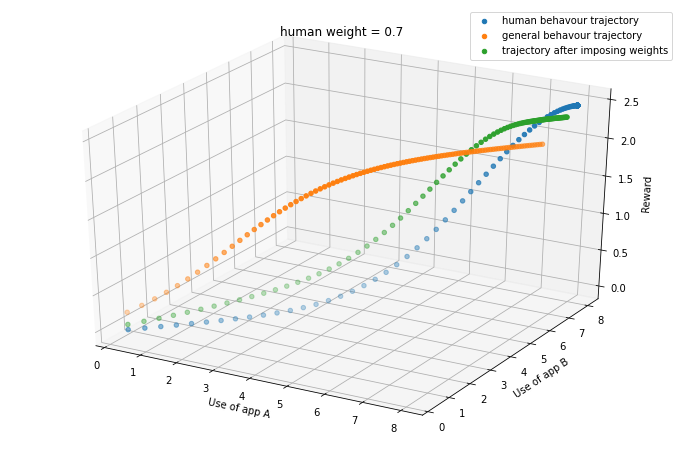

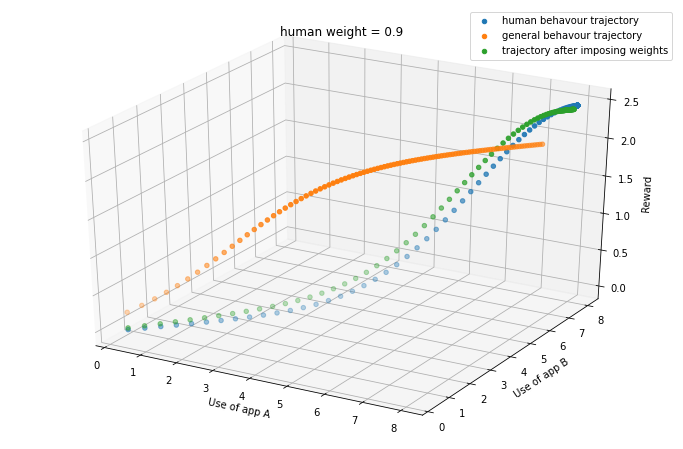

In [ ]:
movement(human_behavour_complement, sigmoid, start, max_itr= 100, human_weight= [0.5, 0.7, 0.9])